# **Librerías**

* Cargar Librerias.
* Carga del df original desde Drive.
* Asignción de nombre al df. 

In [27]:
import matplotlib.pyplot as plot
import seaborn as sns
import numpy as np 
import pandas as pd
import plotly.express as px
import matplotlib.pyplot as plt
import matplotlib.ticker as mtick
from sklearn import preprocessing
from sklearn.model_selection import train_test_split
import plotly.express as px
import seaborn as sb
from sklearn.cluster import KMeans
from sklearn.metrics import pairwise_distances_argmin_min
from sklearn import metrics
import seaborn as sns
from sklearn.cluster import AgglomerativeClustering
from sklearn.cluster import DBSCAN
from sklearn.cluster import MeanShift
from sklearn.cluster import Birch
from sklearn.cluster import AffinityPropagation
from sklearn.cluster import MiniBatchKMeans
import numpy as np
from matplotlib import cm
from sklearn.metrics import silhouette_samples
import seaborn
from scipy.spatial.distance import pdist, squareform
from scipy.cluster.hierarchy import linkage
from scipy.cluster.hierarchy import dendrogram

Cargar data desde drive:

In [28]:
# from google.colab import drive
# drive.mount('/content/drive/')


In [29]:
# df0 =  pd.read_excel('/content/drive/MyDrive/Parcial1/Dataparcial1.xlsx')

df0 =  pd.read_excel('../data/raw/Dataparcial.xlsx')

#**Problema del Dataset**

El problema de clasificación del dataframe es predecir si un individuo gana más o menos de 50,000 dólares al año basado en una serie de características demográficas, laborales y educativas. Es decir, se trata de una tarea de clasificación binaria, donde la variable objetivo es 'CLASE' y las dos subclases son '>50K' (gana más de 50,000 dólares al año) y '<=50K' (gana 50,000 dólares o menos al año).

#**Descripción del dataset**



*   Descripción general del dataset.
*   Descripción de las variables.
*   Diccionario de datos.



##**Descripción general del dataset**

El dataset contiene información sobre aproximadamente 49000 individuos y sus características demográficas, educativas, laborales y de ingresos. Para este caso, se utilizan los datos para el análisis y clasificación. El dataset contiene 14 columnas con información sobre las siguientes características:



##**Descripción de las variables**

1. Edad: Variable numérica continua que representa la edad de la persona.

2. Tipo de trabajo: Variable categórica que indica el tipo de trabajo de la persona, como "privado", "gobierno", "sin fines de lucro", etc.

3. Peso final: Variable numérica continua que indica el peso final de la persona en la muestra.

4. Educación: Variable categórica que indica el nivel educativo de la persona, como "Bachillerato", "Maestría", "Doctorado", etc.

5. Años de educación: Variable numérica continua que indica el número de años de educación formal de la persona.

6. Estado civil: Variable categórica que indica el estado civil de la persona, como "casado", "divorciado", "soltero", etc.

7. Ocupación: Variable categórica que indica la ocupación de la persona, como "administrativo", "artesano", "profesional especializado", etc.

8. Relación: Variable categórica que indica la relación familiar de la persona en la casa, como "esposo", "esposa", "hijo propio", etc.

9. Raza: Variable categórica que indica la raza de la persona, como "blanca", "negra", "asiática-pacífico", "amerindia", etc.

10. Sexo: Variable categórica que indica el género de la persona, Masculino o Femenino.

11. Capital ganado: Variable numérica continua que indica la ganancia de capital de la persona en dólares.

12. Capital perdido: Variable numérica continua que indica la pérdida de capital de la persona en dólares.

13. Horas por semana: Variable numérica continua que indica el número de horas que la persona trabaja por semana.

14. País de origen: Variable categórica que indica el país de origen de la persona.




##**Diccionario de datos**


**Nombre del archivo:** Adult.names/Adult.test

**Descripción:** Base de datos que contendra la plantilla de ...

|Nombre tabla|Campo|Tamano|Tipo de dato|Rango|Descripción|
|---|---|---|---|---|---|
|age|Edad||Numerico||Continuous
|workclass|Tipo de trabajo||Caracter||Private, Self-emp-notinc, Federal-gov, State-gov, Without-pay, Never-worked.|
|fnlwgt|Peso final||Numerico||Continuous|
|education|Educación||Caracter|| Bachelors, Some-college, 11th, HS-grad, Prod-school, Assoc-acdm, Assoc-voc, 9th, 7th-8th, 12th, 1st-4th, 10th|
|education-num|Años de educación||Numerico||Continuous|
|marital-status|Estado civil||Caracter||Married-civ-spouse, Divorced, Never-married, Separated, Widowed, Married-spouse-absent, Married-AF-spouse.|
|occupation|Ocupación||Caracter||Tech-support, Craft-repair, Other-service, Sales, Exec-managerial, Prof-specialty, Handlers-cleaners, Machine-op-ins|
|relationship|Relación||Caracter||Wife, Own-child, Husband, Not-in-family, Other-related, Unmarried.|
|race|Raza||Caracter||White, Assian-Pac-Islander, Amer-Indian-Eskimo, Other, Black|
|sex|Sexo||Caracter||Female, Male.|
|capital-gain|Capital ganado||Numerico||Continuous|
|capital-loss|Capital perdido||Numerico||Continuous|
|hours-per-week|Horas por semana||Numerico||Continuous|
|native-country|País de origen||Caracter||United-States, Cambodia, England, Puerto-Rico, Canada, Germany, Outlying-US(Guam-USVI-etc), India, Japan, Greece, ...|
|Clase|Clase||Caracter|||

##**Descripción del problema** 

El problema de clasificación del dataset es predecir si un individuo gana más o menos de 50,000 dólares al año basado en una serie de características (variables) demográficas, laborales y educativas. Es decir, se trata de una tarea de clasificación binaria, donde la variable objetivo o respuesta es 'CLASE' y sus dos  subclases son '>50K' (gana más de 50,000 dólares al año) y '<=50K' (gana 50,000 dólares o menos al año).

Este conjunto de datos se utiliza para entrenar modelos de aprendizaje automático y evaluar su capacidad para predecir la variable respuesta.

#**Reconocimiento del dataset**

Renombramiento de las variables:


In [30]:
df0.columns = [ 

    'Edad',         
    'Tipo de trabajo',
    'fnlwgt',
    'Educacion',
    'Años de educacion',
    'Estado civil',
    'Ocupacion',
    'Relacion',
    'Raza',
    'Sexo',
    'Capital ganado',
    'Capital perdido',
    'Horas por semana',
    'Pais origen',
    'CLASE',
    ]
df0.info()
df1=df0.copy()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48842 entries, 0 to 48841
Data columns (total 15 columns):
 #   Column             Non-Null Count  Dtype 
---  ------             --------------  ----- 
 0   Edad               48842 non-null  int64 
 1   Tipo de trabajo    48842 non-null  object
 2   fnlwgt             48842 non-null  int64 
 3   Educacion          48842 non-null  object
 4   Años de educacion  48842 non-null  int64 
 5   Estado civil       48842 non-null  object
 6   Ocupacion          48842 non-null  object
 7   Relacion           48842 non-null  object
 8   Raza               48842 non-null  object
 9   Sexo               48842 non-null  object
 10  Capital ganado     48842 non-null  int64 
 11  Capital perdido    48842 non-null  int64 
 12  Horas por semana   48842 non-null  int64 
 13  Pais origen        48842 non-null  object
 14  CLASE              48842 non-null  object
dtypes: int64(6), object(9)
memory usage: 5.6+ MB


Creación filas numeradas:

In [31]:
print (df1.dtypes)
out = ['Fila'+str(item) for item in range (0, df1.shape[0])]
df1.index = out

Edad                  int64
Tipo de trabajo      object
fnlwgt                int64
Educacion            object
Años de educacion     int64
Estado civil         object
Ocupacion            object
Relacion             object
Raza                 object
Sexo                 object
Capital ganado        int64
Capital perdido       int64
Horas por semana      int64
Pais origen          object
CLASE                object
dtype: object


Validación de dimensiones:

In [32]:
df0.shape

(48842, 15)

Validación de datos nulos:

In [33]:
df0.isnull().any()

Edad                 False
Tipo de trabajo      False
fnlwgt               False
Educacion            False
Años de educacion    False
Estado civil         False
Ocupacion            False
Relacion             False
Raza                 False
Sexo                 False
Capital ganado       False
Capital perdido      False
Horas por semana     False
Pais origen          False
CLASE                False
dtype: bool

Validación de suma de posibles datos nulos: 

In [34]:
df0.isnull().sum()

Edad                 0
Tipo de trabajo      0
fnlwgt               0
Educacion            0
Años de educacion    0
Estado civil         0
Ocupacion            0
Relacion             0
Raza                 0
Sexo                 0
Capital ganado       0
Capital perdido      0
Horas por semana     0
Pais origen          0
CLASE                0
dtype: int64

# **Estadistica descriptiva df orginal**

Resumen estadístico:

In [35]:
summary = df1.describe()
print(summary)

               Edad        fnlwgt  Años de educacion  Capital ganado  \
count  48842.000000  4.884200e+04       48842.000000    48842.000000   
mean      38.643585  1.896641e+05          10.078089     1079.067626   
std       13.710510  1.056040e+05           2.570973     7452.019058   
min       17.000000  1.228500e+04           1.000000        0.000000   
25%       28.000000  1.175505e+05           9.000000        0.000000   
50%       37.000000  1.781445e+05          10.000000        0.000000   
75%       48.000000  2.376420e+05          12.000000        0.000000   
max       90.000000  1.490400e+06          16.000000    99999.000000   

       Capital perdido  Horas por semana  
count     48842.000000      48842.000000  
mean         87.502314         40.422382  
std         403.004552         12.391444  
min           0.000000          1.000000  
25%           0.000000         40.000000  
50%           0.000000         40.000000  
75%           0.000000         45.000000  
max    

#**Análisis univariado**

  Barras para variables númericas: 

Text(0.5, 1.0, 'Histograma Edad')

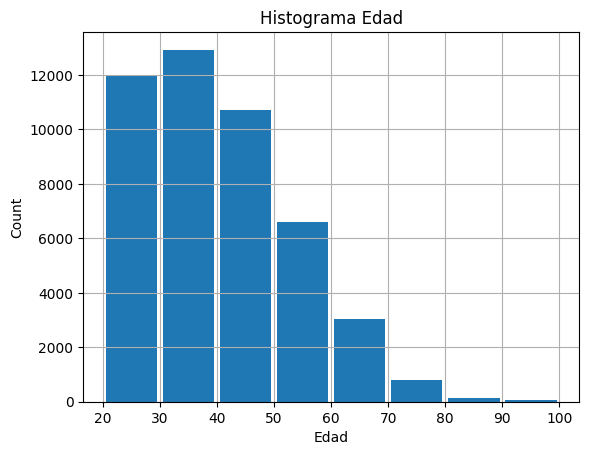

In [36]:
histo=df1['Edad'].hist(bins=[20,30,40,50,60,70,80,90,100],rwidth=0.9)
histo.set(xlabel='Edad', ylabel='Count')  
plt.title ('Histograma Edad')

Boxplot variables númericas:

Edad:

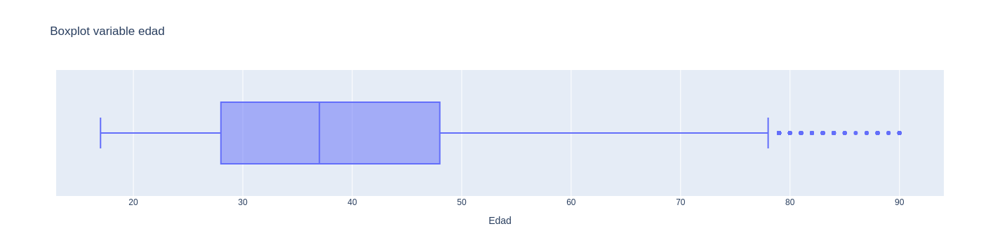

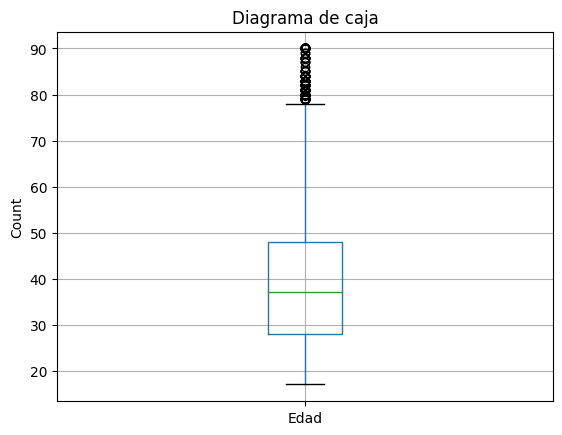

In [37]:
df1.boxplot(column= ['Edad'])
plt.title("Diagrama de caja")
plt.ylabel("Count")
px.box(df1,x='Edad', title='Boxplot variable edad')

Validación datos faltantes:

In [38]:
df2=df1.copy()
#Identificar datos faltantes
df2.isnull().sum()


Edad                 0
Tipo de trabajo      0
fnlwgt               0
Educacion            0
Años de educacion    0
Estado civil         0
Ocupacion            0
Relacion             0
Raza                 0
Sexo                 0
Capital ganado       0
Capital perdido      0
Horas por semana     0
Pais origen          0
CLASE                0
dtype: int64

Tratamiento datos de la variable CLASE:

In [39]:
df2['CLASE'] = df2['CLASE'].str.replace('.', '')
for indice, fila in df2.iterrows():
     valor = fila['CLASE']
     if valor == '<=50K.' or valor =='>50K.':
         print(f"{valor} ")

/tmp/ipykernel_31216/1621383685.py:1: FutureWarning:

The default value of regex will change from True to False in a future version. In addition, single character regular expressions will *not* be treated as literal strings when regex=True.



Asignación de valores int {0, 1} a CLASE:

In [40]:
df3=df2.copy()
df3["NewCLASE"] = df3["CLASE"].apply(lambda x: 1 if x.strip() == ">50K" else 0)
df3['CLASE'] = df3['NewCLASE']
df3.drop('NewCLASE', axis=1, inplace=True)


Validación datos NaN variable Edad:

In [41]:
for indice, fila in df3.iterrows():
    valor = fila['Edad']
    if pd.isna(valor):
        print(f"El valor de edad para la fila {indice} es NaN")

Reemplazo de datos '?' en Clase de trabajo dadas las condiciones de CLASE

In [42]:
#Validar el valor que más se repite para condiciones de Clase 
from collections import Counter
df3_fil1= df3.loc[df3['CLASE'] == 0, 'Tipo de trabajo']
value_counts1 = Counter(df3_fil1)
most_frequent_values1 = value_counts1.most_common()
df3_fil2= df3.loc[df3['CLASE'] == 1, 'Tipo de trabajo']
value_counts2 = Counter(df3_fil2)
most_frequent_values2 = value_counts2.most_common()
print("El valor categórico más frecuente para Tipo de trabajo es:" , most_frequent_values1)
print("El valor categórico más frecuente para Tipo de trabajo es:" , most_frequent_values2)

#Cambio tipo variable tipo object a str, CLASE sigue siendo INT
for col in df3.select_dtypes(include='object'):
    df3[col] = df3[col].astype('string')

#Reemplazo de dato '?' por la moda private
df3['Tipo de trabajo'] = df3['Tipo de trabajo'].str.replace('?', 'Private')
for indice, fila in df3.iterrows():
     valor = fila['Tipo de trabajo']

El valor categórico más frecuente para Tipo de trabajo es: [(' Private', 26519), (' Self-emp-not-inc', 2785), (' ?', 2534), (' Local-gov', 2209), (' State-gov', 1451), (' Federal-gov', 871), (' Self-emp-inc', 757), (' Without-pay', 19), (' Never-worked', 10)]
El valor categórico más frecuente para Tipo de trabajo es: [(' Private', 7387), (' Self-emp-not-inc', 1077), (' Self-emp-inc', 938), (' Local-gov', 927), (' Federal-gov', 561), (' State-gov', 530), (' ?', 265), (' Without-pay', 2)]


/tmp/ipykernel_31216/3648379903.py:17: FutureWarning:

The default value of regex will change from True to False in a future version. In addition, single character regular expressions will *not* be treated as literal strings when regex=True.



Tratamiento de datos variable fnlwgt

In [43]:
for indice, fila in df3.iterrows():
    valor = fila['fnlwgt']
    if pd.isna(valor):
        print(f"El valor de fnlwgt para la fila {indice} es NaN")

Reemplazo de datos '?' en Ocupacion dadas las condiciones de CLASE

In [44]:
#Validar el valor que más se repite para condiciones de Clase 
from collections import Counter
df3_fil1= df3.loc[df3['CLASE'] == 0, 'Ocupacion']
value_counts1 = Counter(df3_fil1)
most_frequent_values1 = value_counts1.most_common()
print("El valor categórico más frecuente para Ocupacion (0:CLASE) es:" , most_frequent_values1)
df3_fil2= df3.loc[df3['CLASE'] == 1, 'Ocupacion']
value_counts2 = Counter(df3_fil2)
most_frequent_values2 = value_counts2.most_common()
print("El valor categórico más frecuente para Ocupacion (1:CLASE) es:" , most_frequent_values1)
#df3.info()

#Reemplazo de dato '?' por la moda Adm-clerical
df3['Ocupacion'] = df3['Ocupacion'].str.replace('?', 'Adm-clerical')
for indice, fila in df3.iterrows():
     valor = fila['Ocupacion']
print(df3)

El valor categórico más frecuente para Ocupacion (0:CLASE) es: [(' Adm-clerical', 4843), (' Craft-repair', 4729), (' Other-service', 4719), (' Sales', 4029), (' Prof-specialty', 3388), (' Exec-managerial', 3178), (' Machine-op-inspct', 2650), (' ?', 2544), (' Handlers-cleaners', 1934), (' Transport-moving', 1874), (' Farming-fishing', 1317), (' Tech-support', 1026), (' Protective-serv', 675), (' Priv-house-serv', 239), (' Armed-Forces', 10)]
El valor categórico más frecuente para Ocupacion (1:CLASE) es: [(' Adm-clerical', 4843), (' Craft-repair', 4729), (' Other-service', 4719), (' Sales', 4029), (' Prof-specialty', 3388), (' Exec-managerial', 3178), (' Machine-op-inspct', 2650), (' ?', 2544), (' Handlers-cleaners', 1934), (' Transport-moving', 1874), (' Farming-fishing', 1317), (' Tech-support', 1026), (' Protective-serv', 675), (' Priv-house-serv', 239), (' Armed-Forces', 10)]


/tmp/ipykernel_31216/3847064910.py:14: FutureWarning:

The default value of regex will change from True to False in a future version. In addition, single character regular expressions will *not* be treated as literal strings when regex=True.



           Edad    Tipo de trabajo  fnlwgt   Educacion  Años de educacion  \
Fila0        39          State-gov   77516   Bachelors                 13   
Fila1        50   Self-emp-not-inc   83311   Bachelors                 13   
Fila2        38            Private  215646     HS-grad                  9   
Fila3        53            Private  234721        11th                  7   
Fila4        28            Private  338409   Bachelors                 13   
...         ...                ...     ...         ...                ...   
Fila48837    39            Private  215419   Bachelors                 13   
Fila48838    64            Private  321403     HS-grad                  9   
Fila48839    38            Private  374983   Bachelors                 13   
Fila48840    44            Private   83891   Bachelors                 13   
Fila48841    35       Self-emp-inc  182148   Bachelors                 13   

                  Estado civil           Ocupacion         Relacion  \
Fila

Reemplazo de datos '?' en Pais Origen dadas las condiciones de CLASE

In [45]:
#Validar el valor que más se repite para condiciones de Clase 
df4=df3.copy()
from collections import Counter
df4_fil1= df4.loc[df4['CLASE'] == 0, 'Pais origen']
value_counts1 = Counter(df4_fil1)
most_frequent_values1 = value_counts1.most_common()
print("El valor categórico más frecuente para Pais origen (0:CLASE) es:" , most_frequent_values1)
df4_fil2= df4.loc[df4['CLASE'] == 1, 'Pais origen']
value_counts2 = Counter(df4_fil2)
most_frequent_values2 = value_counts2.most_common()
print("El valor categórico más frecuente para Pais origen (1:CLASE) es:" , most_frequent_values1)

#Reemplazo de dato '?' por la moda United-States
df4['Pais origen'] = df4['Pais origen'].str.replace('?', 'United-States')
for indice, fila in df4.iterrows():
     valor = fila['Pais origen']
#print(df4)

El valor categórico más frecuente para Pais origen (0:CLASE) es: [(' United-States', 33138), (' Mexico', 904), (' ?', 637), (' Philippines', 210), (' Puerto-Rico', 164), (' Germany', 148), (' El-Salvador', 144), (' Canada', 119), (' Cuba', 104), (' Dominican-Republic', 98), (' South', 95), (' Jamaica', 91), (' India', 89), (' China', 86), (' Guatemala', 85), (' Columbia', 81), (' England', 80), (' Vietnam', 79), (' Italy', 71), (' Poland', 70), (' Haiti', 66), (' Japan', 60), (' Portugal', 55), (' Nicaragua', 46), (' Peru', 42), (' Ecuador', 39), (' Taiwan', 39), (' Iran', 37), (' Greece', 31), (' Ireland', 26), (' Thailand', 25), (' Trinadad&Tobago', 25), (' France', 22), (' Outlying-US(Guam-USVI-etc)', 22), (' Hong', 22), (' Laos', 21), (' Cambodia', 19), (' Honduras', 18), (' Scotland', 18), (' Yugoslavia', 15), (' Hungary', 13), (' Holand-Netherlands', 1)]
El valor categórico más frecuente para Pais origen (1:CLASE) es: [(' United-States', 33138), (' Mexico', 904), (' ?', 637), (' 

/tmp/ipykernel_31216/2213300408.py:14: FutureWarning:

The default value of regex will change from True to False in a future version. In addition, single character regular expressions will *not* be treated as literal strings when regex=True.



#**Análisis bivariado**

Barras paralelas, variable númerica vs categorica (ejemplo)

Text(0, 0.5, 'Tipo de trabajo')

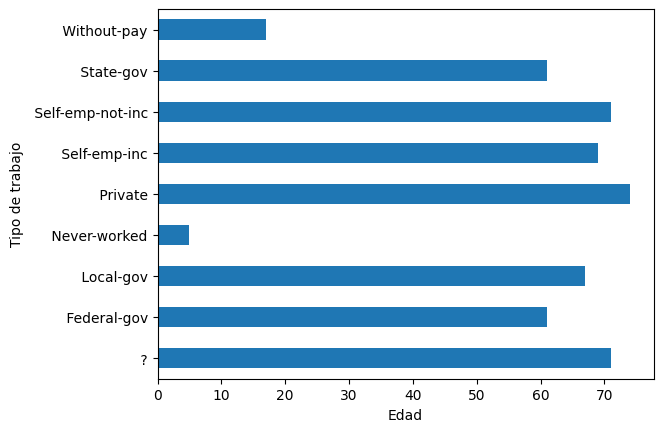

In [46]:
ax= df1.groupby('Tipo de trabajo')['Edad'].nunique().plot(kind='barh')
plt.xlabel('Edad')
plt.ylabel('Tipo de trabajo')

**Boxplot variable edad**

Boxplot variable edad con relacion a la clase

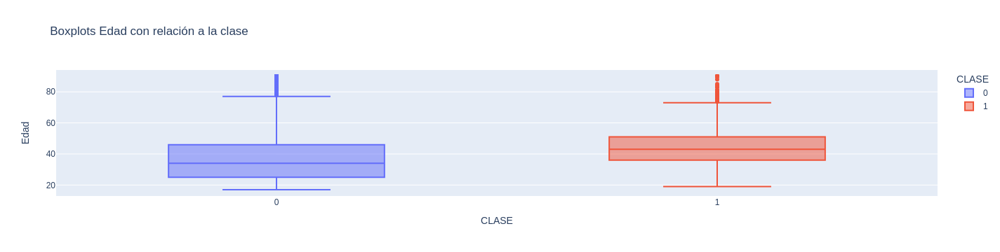

In [47]:
px.box(df4,x = 'CLASE',y='Edad', color='CLASE',
       title='Boxplots Edad con relación a la clase')

Reemplazar datos atipicos variable edad con relacion clase

In [48]:
df4_fil1= df4.loc[df4['CLASE'] == 0, 'Edad':'CLASE']
df4_fil2= df4.loc[df4['CLASE'] == 1, 'Edad':'CLASE']

def impute_outlier(x, remove_na=True):
    # Calcular los percentiles 5 y 85
    quantiles = np.percentile(x, [5, 85], axis=0, keepdims=True)
    
    # Reemplazar los valores por la media o la mediana
    x[x < quantiles[0]] = np.mean(x, axis=0) if remove_na else np.nanmean(x, axis=0)
    x[x > quantiles[1]] = np.median(x, axis=0) if remove_na else np.nanmedian(x, axis=0)
    
    return x

imputed_data_class0 = impute_outlier(df4_fil1["Edad"].values)
imputed_data_class1 = impute_outlier(df4_fil2["Edad"].values)

Verificar con un nuevo boxplot la variable edad con relacion a la clase sin datos atipicos

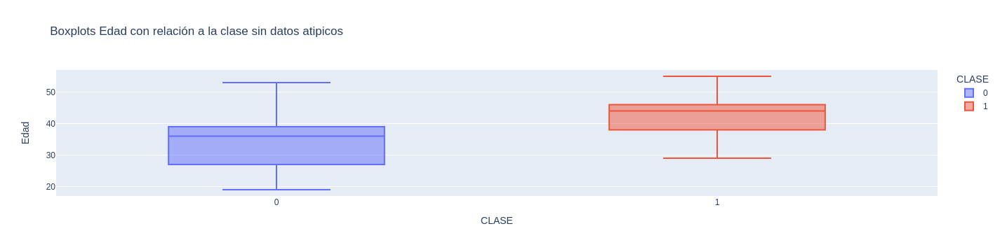

In [49]:
df4_sub0 = pd.concat([df4_fil1, df4_fil2])
px.box(df4_sub0,x = 'CLASE',y='Edad', color='CLASE',
       title='Boxplots Edad con relación a la clase sin datos atipicos')

**Boxplot variable fnlwt**

Boxplot variable fnlwgt con relacion a la clase


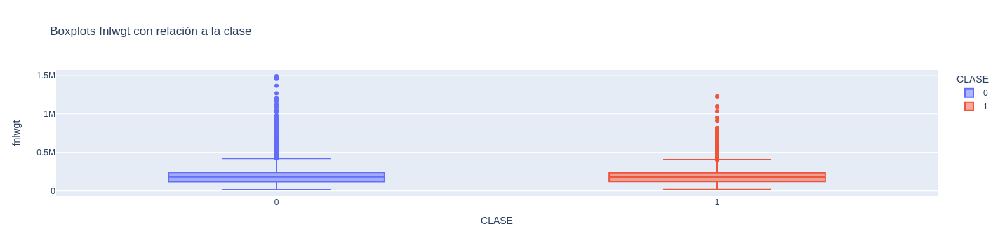

In [50]:
px.box(df4_sub0,x = 'CLASE',y='fnlwgt', color='CLASE',
       title='Boxplots fnlwgt con relación a la clase')

Reemplazar datos atipicos variable fnlwgt con relacion clase

In [51]:
df4_fil3= df4_sub0.loc[df4_sub0['CLASE'] == 0, 'fnlwgt':'CLASE']
df4_fil4= df4_sub0.loc[df4_sub0['CLASE'] == 1, 'fnlwgt':'CLASE']

def impute_outlier(x, remove_na=True):
    # Calcular los percentiles 5 y 85
    quantiles = np.percentile(x, [5, 85], axis=0, keepdims=True)
    
    # Reemplazar los valores por la media o la mediana
    x[x < quantiles[0]] = np.mean(x, axis=0) if remove_na else np.nanmean(x, axis=0)
    x[x > quantiles[1]] = np.median(x, axis=0) if remove_na else np.nanmedian(x, axis=0)
    
    return x

imputed_data_class2 = impute_outlier(df4_fil3["fnlwgt"].values)
imputed_data_class3 = impute_outlier(df4_fil4["fnlwgt"].values)

Verificar con un nuevo boxplot la variable fnlwgt con relacion a la clase sin datos atipicos

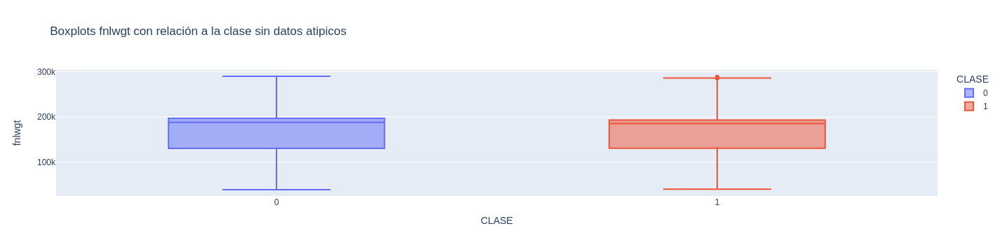

In [52]:
df4_sub1 = pd.concat([df4_fil3, df4_fil4])
px.box(df4_sub1,x = 'CLASE',y='fnlwgt', color='CLASE',
       title='Boxplots fnlwgt con relación a la clase sin datos atipicos')

**Boxplot variable Educacion numero**

Boxplot variable Educacion numero con relacion a la clase

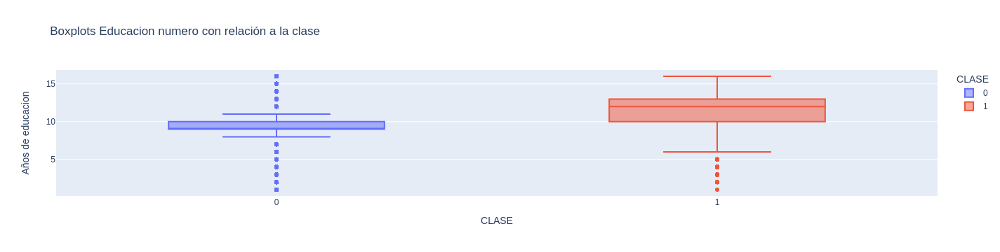

In [53]:
px.box(df4_sub1,x = 'CLASE',y='Años de educacion', color='CLASE',
       title='Boxplots Educacion numero con relación a la clase')

Reemplazar los datos atipicos dados en el bloxplot variable Educacion numero con relacion a la clase

In [54]:
df4_fil5= df4_sub1.loc[df4_sub1['CLASE'] == 0, 'Años de educacion':'CLASE']
df4_fil6= df4_sub1.loc[df4_sub1['CLASE'] == 1, 'Años de educacion':'CLASE']

def impute_outlier(x, remove_na=True):
    # Calcular los percentiles 5 y 85
    quantiles = np.percentile(x, [5, 85], axis=0, keepdims=True)
    
    # Reemplazar los valores por la media o la mediana
    x[x < quantiles[0]] = np.mean(x, axis=0) if remove_na else np.nanmean(x, axis=0)
    x[x > quantiles[1]] = np.median(x, axis=0) if remove_na else np.nanmedian(x, axis=0)
    
    return x

imputed_data_class0 = impute_outlier(df4_fil5["Años de educacion"].values)
imputed_data_class1 = impute_outlier(df4_fil6["Años de educacion"].values)

Verificar con un nuevo boxplot la variable Educacion numero con relacion a la clase sin datos atipicos

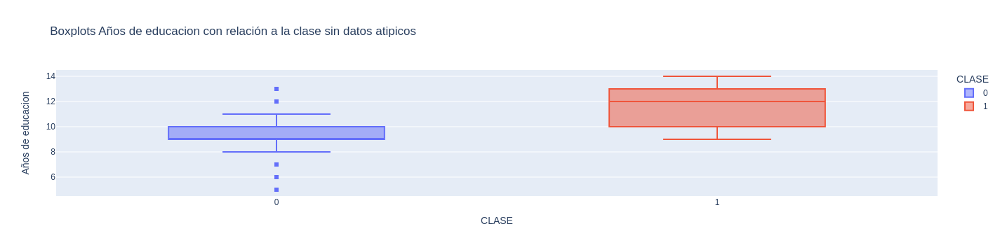

In [55]:
df4_sub2 = pd.concat([df4_fil5, df4_fil6])
px.box(df4_sub2,x = 'CLASE',y='Años de educacion', color='CLASE',
       title='Boxplots Años de educacion con relación a la clase sin datos atipicos')

**Boxplot variable Capital ganado**

Boxplots Capital ganado con relación a la clase

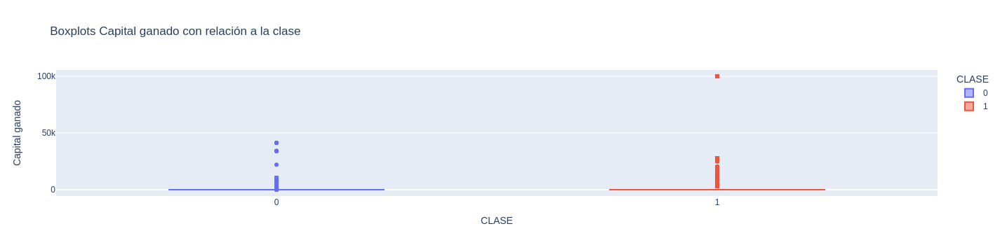

In [56]:
px.box(df4,x = 'CLASE',y='Capital ganado', color='CLASE',
       title='Boxplots Capital ganado con relación a la clase')

Ha esta variable no se le realiza la modificacion ya que la mayoria de los datos estan alrededor del cero



**Boxplot variable Capital perdido**

Boxplots Capital perdido con relación a la clase

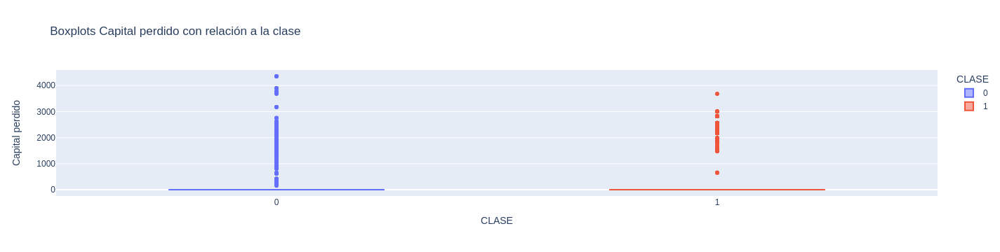

In [57]:
px.box(df4,x = 'CLASE',y='Capital perdido', color='CLASE',
       title='Boxplots Capital perdido con relación a la clase')

Ha esta variable no se le realiza la modificacion ya que la mayoria de los datos estan alrededor del cero

**Boxplot varaible Horas por semana**

Boxplots variable Horas por semana con relación a la clase

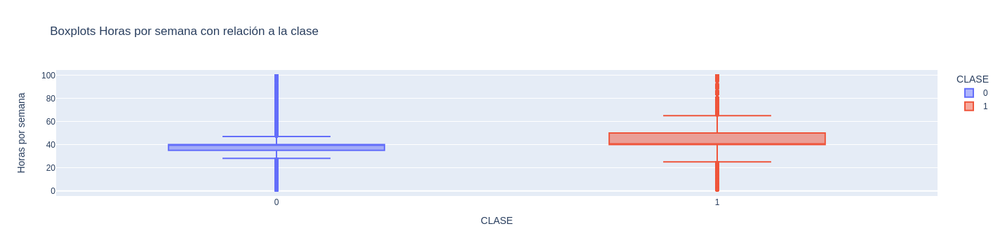

In [58]:
px.box(df4_sub2,x = 'CLASE',y='Horas por semana', color='CLASE',
       title='Boxplots Horas por semana con relación a la clase')

Reemplazar los datos atipicos dados en el bloxplot variable Horas por semana con relacion a la clase

In [59]:
df4_fil7= df4_sub2.loc[df4_sub2['CLASE'] == 0, 'Horas por semana':'CLASE']
df4_fil8= df4_sub2.loc[df4_sub2['CLASE'] == 1, 'Horas por semana':'CLASE']

def impute_outlier(x, remove_na=True):
    # Calcular los percentiles 5 y 85
    quantiles = np.percentile(x, [5, 85], axis=0, keepdims=True)
    
    # Reemplazar los valores por la media o la mediana
    x[x < quantiles[0]] = np.mean(x, axis=0) if remove_na else np.nanmean(x, axis=0)
    x[x > quantiles[1]] = np.median(x, axis=0) if remove_na else np.nanmedian(x, axis=0)
    
    return x

imputed_data_class0 = impute_outlier(df4_fil7["Horas por semana"].values)
imputed_data_class1 = impute_outlier(df4_fil8["Horas por semana"].values)

Verificar con un nuevo boxplot la variable Horas por semana con relacion a la clase sin datos atipicos

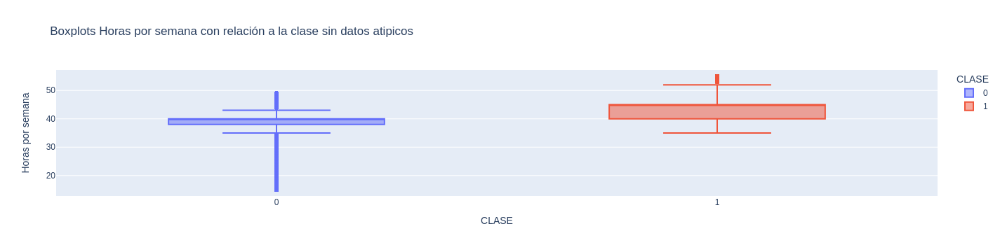

In [60]:
df4_sub3 = pd.concat([df4_fil7, df4_fil8])
px.box(df4_sub3,x = 'CLASE',y='Horas por semana', color='CLASE',
       title='Boxplots Horas por semana con relación a la clase sin datos atipicos')

Crear df5 sin datos atipicos

In [61]:
df5 = pd.DataFrame({'Edad': df4_sub0['Edad'], 'Tipo de trabajo': df4_sub0['Tipo de trabajo'], 'fnlwgt': df4_sub1['fnlwgt'],
                    'Educacion': df4_sub0['Educacion'], 'Años de educacion': df4_sub2['Años de educacion'], 
                    'Estado civil': df4_sub0['Estado civil'], 'Ocupacion': df4_sub0['Ocupacion'], 'Relacion': df4_sub0['Relacion'], 
                    'Raza': df4_sub0['Raza'], 'Sexo': df4_sub0['Sexo'], 'Capital ganado': df4_sub0['Capital ganado'],
                    'Capital perdido': df4_sub0['Capital perdido'], 'Horas por semana': df4_sub3['Horas por semana'], 
                    'Pais origen': df4_sub0['Pais origen'], 'CLASE': df4_sub0['CLASE']})
df5.info()

<class 'pandas.core.frame.DataFrame'>
Index: 48842 entries, Fila0 to Fila48841
Data columns (total 15 columns):
 #   Column             Non-Null Count  Dtype 
---  ------             --------------  ----- 
 0   Edad               48842 non-null  int64 
 1   Tipo de trabajo    48842 non-null  string
 2   fnlwgt             48842 non-null  int64 
 3   Educacion          48842 non-null  string
 4   Años de educacion  48842 non-null  int64 
 5   Estado civil       48842 non-null  string
 6   Ocupacion          48842 non-null  string
 7   Relacion           48842 non-null  string
 8   Raza               48842 non-null  string
 9   Sexo               48842 non-null  string
 10  Capital ganado     48842 non-null  int64 
 11  Capital perdido    48842 non-null  int64 
 12  Horas por semana   48842 non-null  int64 
 13  Pais origen        48842 non-null  string
 14  CLASE              48842 non-null  int64 
dtypes: int64(7), string(8)
memory usage: 6.0+ MB


Validación de dataframe descargando un Excel

In [62]:
df5.to_excel("df5.xlsx", index=False)
from google.colab import files
files.download("df5.xlsx")

ModuleNotFoundError: No module named 'google.colab'

#**Feature engineering**

**Análisis de Correlación**

In [ ]:
from sklearn import preprocessing
matriz_correlacion_df5 = df5.corr(method='pearson')
sns.set(font_scale=0.9)  # Tamaño de la letra
plt.figure(figsize=(14, 5))  # Tamaño de la figura
sns.heatmap(matriz_correlacion_df5, annot=True, cmap='coolwarm', square=True, linewidths=.5, cbar_kws={"shrink": .5})
plt.xticks(rotation=45)
plt.yticks(rotation=0)
plt.title('Matriz de Correlación')
plt.show()


**Codificación de etiquetas(relacionando variables categóricas):**

In [ ]:
# se obtiene la matriz de correlacion de pearson. Si se van a considerar las otras 
# variables
from sklearn import preprocessing
label_encoding = preprocessing.LabelEncoder()
df5['Tipo de trabajo'] = label_encoding.fit_transform(df5['Tipo de trabajo'].astype(str))
df5['Educacion'] = label_encoding.fit_transform(df5['Educacion'].astype(str))
df5['Estado civil'] = label_encoding.fit_transform(df5['Estado civil'].astype(str))
df5['Ocupacion'] = label_encoding.fit_transform(df5['Ocupacion'].astype(str))
df5['Relacion'] = label_encoding.fit_transform(df5['Relacion'].astype(str))
df5['Raza'] = label_encoding.fit_transform(df5['Raza'].astype(str))
df5['Sexo'] = label_encoding.fit_transform(df5['Sexo'].astype(str))
df5['Pais origen'] = label_encoding.fit_transform(df5['Pais origen'].astype(str))
new_matriz_cor = df5.corr(method='pearson')
new_matriz_cor




**sns.heatmap - con matriz de correlación:**

In [ ]:
# se construye un mapa de calor a partir de la matriz de correlación
new_matriz_cor = df5.corr(method='pearson')
sns.set(font_scale=0.7)  # Tamaño de la letra
plt.figure(figsize=(16, 10))  # Tamaño de la figura
sns.heatmap(new_matriz_cor, annot=True, cmap='coolwarm', square=True, linewidths=.5, cbar_kws={"shrink": .5})
plt.xticks(rotation=45)
plt.yticks(rotation=0)
plt.title('Nueva matriz de correlación')
plt.show()



**Selectkbest:** 

In [ ]:
from sklearn.feature_selection import SelectKBest
from numpy import array 
X = df5.drop('CLASE', axis=1)
y = df5['CLASE']
best=SelectKBest(k=5)

features = array(X.columns)
features

In [ ]:
X_new = best.fit_transform(X, y)

filter = best.get_support()
print(features[filter])

In [ ]:
X_new

In [ ]:
df5.info()

In [ ]:
best.scores_

Eliminacion de las columnas Clase de trabajo y  fnlwgt, ya que son las que menos correlacion tienen.

In [ ]:
df5.drop(['fnlwgt', 'Tipo de trabajo'], axis=1, inplace=True)
df5.info()

**Balanceo de datos:**

Sí, es recomendable realizar el análisis de desbalanceo de datos previo a la clasificación en análisis de datos. El desbalanceo de datos se refiere a una situación en la que las clases de interés no están representadas igualmente en el conjunto de datos.

**Algoritmos para validación de desbalanceo:**


En este caso, si se entrena un modelo de clasificación con un conjunto de datos desbalanceado, el modelo puede sesgarse hacia la clase mayoritaria, lo que puede conducir a un rendimiento deficiente en la clasificación de la clase minoritaria.

Por lo tanto, es importante realizar un análisis de desbalanceo de datos para identificar cualquier desequilibrio y decidir si se requiere un tratamiento especial para la clase minoritaria antes de la clasificación. Esto puede incluir la recopilación de más datos de la clase minoritaria, el aumento de datos para equilibrar las clases o el uso de técnicas de clasificación específicas para manejar el desbalanceo de datos.

In [ ]:
#Análisis exploratorio para identificar si existe desequilibrio de la CLASE
print (df5['CLASE'].value_counts())
#Se corrobora la Frecuencia por CLASE
print (pd.value_counts(df5['CLASE'], sort = True))
#Se corrobora graficamente
def crearBarras (etiquetas, y):
  count_classes = pd.value_counts(y, sort = True)
  count_classes.plot(kind = 'bar', rot=0)
  plt.xticks(range(2), etiquetas)
  plt.title("Frecuencia de acuerdo al número de observaciones")
  plt.xlabel("CLASE")
  plt.ylabel("cantidad de observaciones");

etiquetas= ['0','1']
crearBarras ( etiquetas, df5['CLASE'])

Generación del modelo sin analizar el desbalance:

In [63]:
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.decomposition import PCA
from sklearn.tree import DecisionTreeClassifier
from pylab import rcParams
from imblearn.under_sampling import NearMiss
from imblearn.over_sampling import RandomOverSampler
from imblearn.combine import SMOTETomek
from imblearn.ensemble import BalancedBaggingClassifier
from collections import Counter

#Definición de etiquetas
y = df5['CLASE']
X = df5.drop('CLASE', axis=1)

# Se divide el dataset en entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, train_size= 0.7)
 
# Se genera la función para ejecutar el modelo
def ejecutar_modelo(X_train, X_test, y_train, y_test):
    clf = DecisionTreeClassifier(criterion='entropy')
    # Train Decision Tree Classifer
    clf = clf.fit(X_train,y_train)
    return clf
 
# Se corre el modelo
model = ejecutar_modelo(X_train, X_test, y_train, y_test)
 
#Se define una funcion para mostrar los resultados
def mostrar_resultados(y_test, pred_y):
    conf_matrix = confusion_matrix(y_test, pred_y)
    plt.figure(figsize=(12, 12))
    sns.heatmap(conf_matrix, xticklabels=etiquetas, yticklabels=etiquetas, annot=True, fmt="d");
    plt.title("Confusion matrix")
    plt.ylabel('True class')
    plt.xlabel('Predicted class')
    plt.show()
    print (classification_report(y_test, pred_y))
 
 # se obtiene la predicción y se presentan los resultados
pred_y = model.predict(X_test)
mostrar_resultados(y_test, pred_y)

ValueError: could not convert string to float: ' Private'

Informe de clasificación obtenido después de evaluar el rendimiento de un modelo de clasificación en un conjunto de datos de prueba. El informe presenta varias métricas de evaluación del modelo.

La precisión (precision) es la fracción de verdaderos positivos entre todos los valores predichos como positivos. En este caso, la precisión para la clase 0 es 0.94, lo que significa que el 94% de los valores clasificados como clase 0 son verdaderamente de la clase 0. La precisión para la clase 1 es 0.81, lo que significa que el 81% de los valores clasificados como clase 1 son verdaderamente de la clase 1.

El recall es la fracción de verdaderos positivos que se identificaron correctamente de entre todos los valores que realmente son positivos. El recall para la clase 0 es 0.94, lo que significa que el 94% de los valores verdaderamente de la clase 0 fueron identificados correctamente por el modelo. El recall para la clase 1 es 0.82, lo que significa que el 82% de los valores verdaderamente de la clase 1 fueron identificados correctamente por el modelo.

El f1-score es una medida de la precisión y el recall, y es el promedio ponderado de la precisión y el recall. El f1-score para la clase 0 es 0.94, lo que indica una buena precisión y recall para la clase 0. El f1-score para la clase 1 es 0.81, lo que indica que la precisión y el recall para la clase 1 no son tan buenos como para la clase 0.

La macro avg y weighted avg son el promedio de las métricas para todas las clases y se calculan para proporcionar una evaluación general del rendimiento del modelo. En este caso, la macro avg y weighted avg son similares, lo que indica que el conjunto de datos está equilibrado.

La precisión global del modelo se refleja en la exactitud (accuracy), que es la proporción de predicciones correctas entre todas las predicciones. En este caso, la exactitud del modelo es del 91%, lo que indica que el modelo clasifica correctamente el 91% de los datos de prueba.






Penalización para compensar:

In [64]:
# Se genera la función para ejecutar el modelo
# Se trabaja con el 30% de los datos (datos de entrenamiento)
def ejecutar_balanceo_Penalizacion(X_train, X_test, y_train, y_test):
    clf = DecisionTreeClassifier(criterion='entropy', class_weight="balanced")
    # Train Decision Tree Classifer
    clf = clf.fit(X_train,y_train)
    pd.value_counts(df5['CLASE'], sort = True)
    return clf

model = ejecutar_balanceo_Penalizacion(X_train, X_test, y_train, y_test)
pred_y = model.predict(X_test)

crearBarras (etiquetas, pred_y)

mostrar_resultados(y_test, pred_y)

ValueError: could not convert string to float: ' Private'

**Una vez realizado el analisis del balanceo de los datos de la CLASE, se procede a implementar las estrategias de balanceo de datos: Subsampling, Oversampling, etc...**

**Subsampling en la clase mayoritaria:**

El Subsampling es una técnica de muestreo que se utiliza en el análisis de datos y el aprendizaje automático. Consiste en tomar una muestra aleatoria de los datos originales para reducir el tamaño del conjunto de datos, lo que puede ser útil cuando el conjunto de datos original es demasiado grande para trabajar con él en su totalidad o cuando el conjunto de datos está desbalanceado.

En el caso de desbalanceo de clases, el Subsampling se utiliza para equilibrar la proporción de observaciones entre las diferentes clases. Por ejemplo, si un conjunto de datos tiene 1.000 observaciones, de las cuales 900 pertenecen a la clase 0 y solo 100 a la clase 1, puede ser necesario realizar un Subsampling de la clase 0 para reducir el número de observaciones a 100 y así tener una proporción equilibrada de observaciones de cada clase.

Existen varios tipos de Subsampling, como el Subsampling aleatorio y el Subsampling estratificado. En el Subsampling aleatorio, se seleccionan aleatoriamente un número fijo de observaciones de cada clase, mientras que en el Subsampling estratificado, se seleccionan observaciones de cada clase de manera proporcional a su tamaño en el conjunto de datos original.

Es importante tener en cuenta que el Subsampling puede tener un impacto en la precisión de los modelos de aprendizaje automático, ya que al reducir el tamaño del conjunto de datos, también se pueden perder algunos patrones y características importantes presentes en los datos originales. Por lo tanto, es importante elegir cuidadosamente el tamaño de la muestra y la técnica de Subsampling adecuada para el conjunto de datos y el problema en cuestión.

In [65]:
#Esta tecnica trabaja con el 70% de los datos 

us = NearMiss()
X_train_res, y_train_res = us.fit_resample(X_train, y_train)
 
print ("Antes de  resampling {}".format(Counter(y_train)))
print ("Despues del  resampling {}".format(Counter(y_train_res)))
crearBarras (etiquetas, y_train_res)
 
model = ejecutar_modelo(X_train_res, X_test, y_train_res, y_test)
pred_y = model.predict(X_test)

mostrar_resultados(y_test, pred_y)

ValueError: could not convert string to float: ' Private'

**Oversampling de la clase minoritaria:**


El Oversampling es una técnica utilizada en el análisis de datos y el aprendizaje automático para equilibrar la proporción de observaciones entre las diferentes clases en un conjunto de datos desbalanceado. A diferencia del Subsampling, que reduce el tamaño del conjunto de datos, el Oversampling consiste en generar nuevos ejemplos sintéticos de la clase minoritaria hasta igualar su número de observaciones con el de la clase mayoritaria.

Existen varios métodos para implementar el Oversampling, como por ejemplo:

Duplicar observaciones: esta técnica consiste en duplicar las observaciones de la clase minoritaria hasta igualar su número de observaciones con la clase mayoritaria. Esta técnica puede generar un sobreajuste en el modelo, ya que se están agregando observaciones idénticas al conjunto de datos.
SMOTE (Synthetic Minority Over-sampling Technique): esta técnica es una de las más populares. En lugar de duplicar las observaciones de la clase minoritaria, SMOTE genera nuevos ejemplos sintéticos mediante la interpolación entre los ejemplos existentes en la clase minoritaria. SMOTE tiene en cuenta los vecinos más cercanos de las observaciones de la clase minoritaria y utiliza sus características para crear nuevos ejemplos sintéticos que son plausibles y no idénticos a las observaciones existentes.


In [66]:
os =  RandomOverSampler()
X_train_res, y_train_res = os.fit_resample(X_train, y_train)
 
print ("Antes de  resampling {}".format(Counter(y_train)))
print ("Despues del  resampling {}".format(Counter(y_train_res)))
crearBarras (etiquetas, y_train_res)

model = ejecutar_modelo(X_train_res, X_test, y_train_res, y_test)
pred_y = model.predict(X_test)
mostrar_resultados(y_test, pred_y)

#Pregunta: Se debe crear un nuevo df con los datos balanceados?
# A partir de este nuevo df se aplican los algoritmos de Clasificación?



Antes de  resampling Counter({0: 26072, 1: 8117})
Despues del  resampling Counter({0: 26072, 1: 26072})


NameError: name 'crearBarras' is not defined

**Resampling con Smote-Tomek:**

In [67]:
df5['CLASE'].value_counts()


0    37155
1    11687
Name: CLASE, dtype: int64

In [68]:
X = df5.drop('CLASE',axis = 1)
Y = df5['CLASE']
X.shape,Y.shape

((48842, 14), (48842,))

In [69]:
from imblearn.combine import SMOTETomek
os_us = SMOTETomek()
X_train_res, y_train_res = os_us.fit_resample(X_train, y_train)
 
print ("Distribution before resampling {}".format(Counter(y_train)))
print ("Distribution after resampling {}".format(Counter(y_train_res)))
 
model = ejecutar_modelo(X_train_res, X_test, y_train_res, y_test)
pred_y = model.predict(X_test)
mostrar_resultados(y_test, pred_y)

ValueError: could not convert string to float: ' Private'

**SMOTEENN:**

*Esta técnica es la que mejor precisión con respecto a las otras técnicas, esto para las dos subcategorías de CLASE.*

SMOTEENN es una técnica de muestreo de datos que combina la técnica de sobremuestreo SMOTE (Synthetic Minority Over-sampling Technique) con la técnica de submuestreo Edited Nearest Neighbours (ENN). Esta técnica se utiliza para abordar el problema de desequilibrio de clases en conjuntos de datos binarios.

El sobremuestreo SMOTE genera observaciones sintéticas para la clase minoritaria mediante la interpolación entre las observaciones existentes de esa clase. Por otro lado, la técnica de submuestreo ENN elimina las observaciones de la clase mayoritaria que están cerca de las observaciones de la clase minoritaria, lo que puede ayudar a eliminar el ruido y reducir el impacto de las observaciones de la clase mayoritaria en la clasificación.

La técnica SMOTEENN combina estas dos técnicas. Primero, se utiliza SMOTE para generar nuevas observaciones sintéticas para la clase minoritaria. Luego, se utiliza ENN para eliminar las observaciones de la clase mayoritaria que están cerca de las nuevas observaciones sintéticas. Esto puede ayudar a abordar el desequilibrio de clases al aumentar la cantidad de datos de la clase minoritaria y reducir la influencia de los datos de la clase mayoritaria en la clasificación.

In [70]:
print('Original dataset shape {}'.format(Counter(Y)))
print('Resampled dataset shape {}'.format(Counter(y_train_res)))

Original dataset shape Counter({0: 37155, 1: 11687})
Resampled dataset shape Counter({0: 26072, 1: 26072})


In [71]:
from imblearn.combine import SMOTEENN
smk = SMOTEENN()
#X_res,y_res=smk.fit_resample(X,Y)
#X_res.shape,y_res.shape

X_train_res, y_train_res = smk.fit_resample(X_train, y_train)
 
print ("Distribution before resampling {}".format(Counter(y_train)))
print ("Distribution after resampling {}".format(Counter(y_train_res)))
 
model = ejecutar_modelo(X_train_res, X_test, y_train_res, y_test)
pred_y = model.predict(X_test)
mostrar_resultados(y_test, pred_y)

ValueError: could not convert string to float: ' Private'

In [72]:
print('Original dataset shape {}'.format(Counter(Y)))
print('Resampled dataset shape {}'.format(Counter(y_train_res)))

Original dataset shape Counter({0: 37155, 1: 11687})
Resampled dataset shape Counter({0: 26072, 1: 26072})


La selección de una técnica para equilibrar los datos de una clase, también conocido como abordar el desequilibrio de datos, puede depender de varios criterios, algunos de ellos son:

La distribución de las clases: La distribución de las clases puede influir en la elección de la técnica a utilizar. Si la clase minoritaria tiene una proporción muy pequeña en relación con la clase mayoritaria, es posible que sea necesario utilizar técnicas de sobremuestreo para crear nuevas muestras de la clase minoritaria. Si la clase mayoritaria es muy grande, puede ser necesario utilizar técnicas de submuestreo para reducir el tamaño de la clase mayoritaria.
El tamaño del conjunto de datos: El tamaño del conjunto de datos puede influir en la elección de la técnica de muestreo, ya que algunas técnicas de sobremuestreo pueden aumentar significativamente el tamaño del conjunto de datos.

La complejidad del modelo: La complejidad del modelo también puede influir en la elección de la técnica de muestreo, ya que algunas técnicas pueden generar ruido y redundancia en el conjunto de datos, lo que puede afectar negativamente la precisión y la interpretación del modelo.

La naturaleza del problema: La naturaleza del problema y la importancia relativa de las clases pueden influir en la elección de la técnica de muestreo. Por ejemplo, en un problema médico donde la detección de la clase minoritaria es crítica, se puede utilizar una técnica de sobremuestreo para aumentar la cantidad de datos de la clase minoritaria.

El tipo de modelo: El tipo de modelo que se utilizará para la clasificación también puede influir en la elección de la técnica de muestreo. Por ejemplo, algunos modelos como los árboles de decisión y las redes neuronales pueden ser más sensibles al desequilibrio de datos que otros modelos como las regresiones logísticas.

La disponibilidad de recursos: La elección de la técnica de muestreo también puede depender de la disponibilidad de recursos, como la potencia de procesamiento, el tiempo y los costos.

**Para tener en cuenta a la hora de leer los resultados de la matriz de confusión:**

La matriz de confusión puede influir en la decisión de qué técnica de balanceo aplicar. La matriz de confusión proporciona información sobre el desempeño del modelo de clasificación y permite evaluar cómo se están clasificando las muestras en cada clase. Si la matriz de confusión muestra un alto número de falsos positivos o falsos negativos en una clase minoritaria, es posible que sea necesario aplicar técnicas de balanceo para mejorar el rendimiento del modelo en esa clase y reducir el sesgo hacia la clase mayoritaria. En ese caso, se puede considerar la aplicación de técnicas de sobre-muestreo como SMOTE o de sub-muestreo como NearMiss, o incluso la combinación de ambas técnicas como SMOTEENN. Sin embargo, la selección de la técnica de balanceo adecuada también debe basarse en otros factores, como el tamaño del conjunto de datos, la distribución de las clases y los recursos computacionales disponibles.

**Seleccion metodo de balanceo**

Dado que el metodo de balanceo Smoteenn nos da una mejor precisios, recall y f1-score, este sera el metodo de balanceo a seleccionar. 
Por ende a partir de los datos creados por medio de este modelo se crea un nuevo dataFrame.

In [73]:
df6 = pd.concat([X_train_res, y_train_res], axis = 1)

In [74]:
df6.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 52144 entries, 0 to 52143
Data columns (total 15 columns):
 #   Column             Non-Null Count  Dtype 
---  ------             --------------  ----- 
 0   Edad               52144 non-null  int64 
 1   Tipo de trabajo    52144 non-null  string
 2   fnlwgt             52144 non-null  int64 
 3   Educacion          52144 non-null  string
 4   Años de educacion  52144 non-null  int64 
 5   Estado civil       52144 non-null  string
 6   Ocupacion          52144 non-null  string
 7   Relacion           52144 non-null  string
 8   Raza               52144 non-null  string
 9   Sexo               52144 non-null  string
 10  Capital ganado     52144 non-null  int64 
 11  Capital perdido    52144 non-null  int64 
 12  Horas por semana   52144 non-null  int64 
 13  Pais origen        52144 non-null  string
 14  CLASE              52144 non-null  int64 
dtypes: int64(7), string(8)
memory usage: 6.0 MB


In [75]:
df6.head()

,Edad,Tipo de trabajo,fnlwgt,Educacion,Años de educacion,Estado civil,Ocupacion,Relacion,Raza,Sexo,Capital ganado,Capital perdido,Horas por semana,Pais origen,CLASE
0,22,Private,105686,HS-grad,9,Never-married,Handlers-cleaners,Unmarried,White,Male,0,0,40,United-States,0
1,30,Private,207668,Bachelors,13,Never-married,Tech-support,Not-in-family,White,Male,0,0,40,Hungary,0
2,41,Private,160785,Assoc-voc,11,Married-civ-spouse,Exec-managerial,Husband,White,Male,0,0,40,United-States,1
3,36,Private,98436,Masters,9,Married-civ-spouse,Other-service,Husband,White,Male,0,0,40,United-States,0
4,44,Private,182460,HS-grad,9,Married-civ-spouse,Exec-managerial,Husband,White,Male,0,0,45,United-States,1


#  **Estadística descriptiva DF transformado**

**Descripción estadística:**

In [76]:
summary = df6.describe()
print(summary)

               Edad         fnlwgt  Años de educacion  Capital ganado  \
count  52144.000000   52144.000000       52144.000000    52144.000000   
mean      38.125748  169077.662627          10.552240     2047.684240   
std        8.758811   53863.064580           2.006853    10413.398238   
min       19.000000   39581.000000           5.000000        0.000000   
25%       32.000000  130057.000000           9.000000        0.000000   
50%       38.000000  185647.000000          10.000000        0.000000   
75%       44.000000  195568.000000          13.000000        0.000000   
max       55.000000  289944.000000          14.000000    99999.000000   

       Capital perdido  Horas por semana         CLASE  
count     52144.000000       52144.00000  52144.000000  
mean        119.688382          40.55667      0.500000  
std         472.356021           6.74864      0.500005  
min           0.000000          15.00000      0.000000  
25%           0.000000          40.00000      0.000000  


# **Técnicas predictivas**

**ALGORITMOS DE CLASIFICACIÓN (Algoritmos de aprendizaje automático):**




Ejemplos:

Regresión lineal: un algoritmo de aprendizaje automático que se utiliza para predecir valores numéricos continuos.

Árboles de decisión: un algoritmo que utiliza una estructura de árbol para modelar decisiones y sucesos probabilísticos.

K-Vecinos más cercanos: un algoritmo que utiliza una función de distancia para encontrar los k puntos más cercanos a un punto de consulta.

Redes neuronales: un conjunto de algoritmos que utilizan modelos inspirados en el cerebro humano para procesar información.

Máquinas de vectores de soporte: un algoritmo que se utiliza para la clasificación y regresión, que trata de encontrar la mejor separación entre diferentes clases.

Clustering: un conjunto de algoritmos que agrupan datos no etiquetados en grupos basados en características comunes.

Naive Bayes: un algoritmo que se utiliza para la clasificación y predicción de texto y otros datos no numéricos.

Aprendizaje por refuerzo: un algoritmo que se utiliza para la toma de decisiones y el control de acciones en entornos dinámicos.

##**Clasificación Árbol de decisión:**

In [79]:
from sklearn.tree import DecisionTreeClassifier # Import Decision Tree Classifier
from sklearn.model_selection import train_test_split # Import train_test_split function
from sklearn import metrics #Import scikit-learn metrics module for accuracy calculation
from sklearn.tree import export_graphviz
import pydotplus
from sklearn import tree
from sklearn.tree import export_graphviz
import graphviz
import numpy as np 

print (df6.dtypes)
#split dataset in features and target variable
feature_cols = ['Edad', 'Educacion', 'Años de educacion', 'Estado civil','Ocupacion','Relacion' , 'Raza' , 'Sexo' , 'Capital ganado',
                'Capital perdido' , 'Horas por semana' , 'Pais origen']
X = df6[feature_cols] # Features
y = df6.CLASE # Target variable, la clase es la ultima columna
# Split dataset into training set and test set
#random_state generador de numero aleatorios (semilla usada por el generador)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=1) # 70% training and 30% test

# Create Decision Tree classifer object
#verificar si usa Gini o usa entropia
clf = DecisionTreeClassifier(criterion='entropy')
# Train Decision Tree Classifer
clf = clf.fit(X_train,y_train)    

Edad                  int64
Tipo de trabajo      string
fnlwgt                int64
Educacion            string
Años de educacion     int64
Estado civil         string
Ocupacion            string
Relacion             string
Raza                 string
Sexo                 string
Capital ganado        int64
Capital perdido       int64
Horas por semana      int64
Pais origen          string
CLASE                 int64
dtype: object


ValueError: could not convert string to float: ' Assoc-voc'

In [80]:
clf 

DecisionTreeClassifier(criterion='entropy')

### **Predicciones**

In [81]:
#Predict the response for test dataset
print ("Se hacen las predicciones")
y_pred = clf.predict(X_test)
y_pred

Se hacen las predicciones


ValueError: could not convert string to float: ' Some-college'

In [82]:
y2_pred = clf.predict(X_test)

print("La prediccion "+str(y2_pred))

ValueError: could not convert string to float: ' Some-college'

### **Performance**

In [83]:
import sklearn.metrics as metrics
# Model Accuracy, how often is the classifier correct?

print("Accuracy:\n",metrics.accuracy_score(y_test, y_pred))

NameError: name 'y_pred' is not defined

### **Grabar el árbol**

In [84]:
from sklearn.tree import export_graphviz
import pydotplus
# se graba el árbol
dot_data = export_graphviz(clf, out_file=None, filled=True, feature_names = feature_cols, class_names=['0','1', '2'])
graph = pydotplus.graph_from_dot_data(dot_data)
graph.write_pdf('/content/drive/MyDrive/Parcial1/tree2.pdf')


AttributeError: 'DecisionTreeClassifier' object has no attribute 'n_features_in_'

### **Calcular importancia de cada atributo**

In [85]:
# se obtiene la importancia de cada atributo a partir del arbol
print("for para calcular la importancia de cada atributo")

# se crea un diccionario
diccionario = {}
# tree.feature_importances_ se obtiene la importancia de cada atributo
#zip  devuelve un iterador de tuplas basado en los objetos iterables 
for name, importance in zip(feature_cols, clf.feature_importances_):
    diccionario[name] = importance

import operator
sortedDict = sorted(diccionario.items(), key=operator.itemgetter(1))

sortedDict



for para calcular la importancia de cada atributo


AttributeError: 'DecisionTreeClassifier' object has no attribute 'tree_'

### **Matriz de confusión**

In [86]:
# matriz de confusion
from sklearn.metrics import confusion_matrix
print(confusion_matrix(y_test, y_pred))

NameError: name 'y_pred' is not defined

### **Classification_report**

In [87]:
from sklearn.metrics import classification_report
print(classification_report(y_test, y_pred))

NameError: name 'y_pred' is not defined

### **Validación cruzada**

In [88]:
# se efectúa validación cruzada
from sklearn import model_selection
kFold = model_selection.KFold(n_splits=10)
scoring = 'accuracy'
puntaje= (model_selection.cross_val_score(clf, X_train, y_train,  scoring = scoring, cv = kFold))
print (f"( {puntaje.mean()}, {puntaje.std()}")

ValueError: 
All the 10 fits failed.
It is very likely that your model is misconfigured.
You can try to debug the error by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
1 fits failed with the following error:
Traceback (most recent call last):
  File "/home/diegoluisr/.local/lib/python3.8/site-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/home/diegoluisr/.local/lib/python3.8/site-packages/sklearn/tree/_classes.py", line 889, in fit
    super().fit(
  File "/home/diegoluisr/.local/lib/python3.8/site-packages/sklearn/tree/_classes.py", line 186, in fit
    X, y = self._validate_data(
  File "/home/diegoluisr/.local/lib/python3.8/site-packages/sklearn/base.py", line 579, in _validate_data
    X = check_array(X, input_name="X", **check_X_params)
  File "/home/diegoluisr/.local/lib/python3.8/site-packages/sklearn/utils/validation.py", line 879, in check_array
    array = _asarray_with_order(array, order=order, dtype=dtype, xp=xp)
  File "/home/diegoluisr/.local/lib/python3.8/site-packages/sklearn/utils/_array_api.py", line 185, in _asarray_with_order
    array = numpy.asarray(array, order=order, dtype=dtype)
  File "/home/diegoluisr/.local/lib/python3.8/site-packages/pandas/core/generic.py", line 2070, in __array__
    return np.asarray(self._values, dtype=dtype)
ValueError: could not convert string to float: ' 7th-8th'

--------------------------------------------------------------------------------
9 fits failed with the following error:
Traceback (most recent call last):
  File "/home/diegoluisr/.local/lib/python3.8/site-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/home/diegoluisr/.local/lib/python3.8/site-packages/sklearn/tree/_classes.py", line 889, in fit
    super().fit(
  File "/home/diegoluisr/.local/lib/python3.8/site-packages/sklearn/tree/_classes.py", line 186, in fit
    X, y = self._validate_data(
  File "/home/diegoluisr/.local/lib/python3.8/site-packages/sklearn/base.py", line 579, in _validate_data
    X = check_array(X, input_name="X", **check_X_params)
  File "/home/diegoluisr/.local/lib/python3.8/site-packages/sklearn/utils/validation.py", line 879, in check_array
    array = _asarray_with_order(array, order=order, dtype=dtype, xp=xp)
  File "/home/diegoluisr/.local/lib/python3.8/site-packages/sklearn/utils/_array_api.py", line 185, in _asarray_with_order
    array = numpy.asarray(array, order=order, dtype=dtype)
  File "/home/diegoluisr/.local/lib/python3.8/site-packages/pandas/core/generic.py", line 2070, in __array__
    return np.asarray(self._values, dtype=dtype)
ValueError: could not convert string to float: ' Assoc-voc'


## **KNN**

Parla ...

In [89]:
# Librerias
from sklearn import neighbors, datasets, preprocessing
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score

# se particiona el dataset en entrenamiento y de prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=33)

# Se usa estandarización
scaler = preprocessing.StandardScaler().fit(X_train)

X_train = scaler.transform(X_train)
X_test = scaler.transform(X_test)

# Se usa el knn
knn = neighbors.KNeighborsClassifier(n_neighbors=5)

# Entrenamiento
knn.fit(X_train, y_train)

# Prediccion
y_pred = knn.predict(X_test)

# Evaluacion
accuracy_score(y_test, y_pred)

ValueError: could not convert string to float: ' Bachelors'

## **Bayes**

In [90]:
from sklearn.feature_selection import SelectKBest
from sklearn.naive_bayes import GaussianNB
X = df6.drop('CLASE', axis=1)
Y = df6['CLASE']

#este es un metodo de seleccion de caracteristicas
#le da puntaje a cada caracteristica y borra todas las demas
#excepto las que tienen puntaje mas alto

#https://aprendeia.com/metodos-de-seleccion-de-caracteristicas-machine-learning/
best=SelectKBest(k=5)
print (y)
X_new = best.fit_transform(X, y)
selected = best.get_support(indices=True)
caracteristicasUsadas =X.columns[selected]
print(caracteristicasUsadas)

# Split dataset in training and test datasets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=1) 

gnb = GaussianNB()

# Train classifier
gnb.fit(X_train[caracteristicasUsadas].values, y_train)
#se predice con las variables seleccionadas
y_pred = gnb.predict(X_test[caracteristicasUsadas])
 #Devuelve la precisión media en los datos y etiquetas de prueba dados.
print('Precision con el set de prueba: {:.2f}'.format(gnb.score(X_test[caracteristicasUsadas], y_test)))
print('Se obtiene la precision con el dataset de entrenamiento: {:.2f}'.format(gnb.score(X_train[caracteristicasUsadas], y_train)))

#                 ['ingresos', 'ahorros', 'hijos', 'trabajo', 'financiar']
print("se hace prediccion")
print(gnb.predict([[1000,        4000,     1,       6,         100000]]))
#Resultado esperado 0-Alquilar, 1-Comprar casa

0        0
1        0
2        1
3        0
4        1
        ..
52139    1
52140    1
52141    1
52142    1
52143    1
Name: CLASE, Length: 52144, dtype: int64


ValueError: could not convert string to float: ' Private'

Se agregan import

In [91]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score

from sklearn.linear_model import LogisticRegression
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis
from sklearn.linear_model import SGDClassifier
from sklearn.svm import LinearSVC
from sklearn.neighbors import RadiusNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.tree import DecisionTreeClassifier
from sklearn import neighbors, datasets, preprocessing
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.metrics import f1_score

In [92]:
# basado en función de José Ricardo Zapata
def obtener_performance_classification(y_true, y_pred):
    
    accuracy = accuracy_score(y_true, y_pred, normalize=True)
    prec = precision_score(y_true, y_pred)
    recall = recall_score(y_true, y_pred)
    f1_score1 = f1_score(y_true, y_pred, average='macro') 
    
    return {'accuracy': accuracy, 
            'precision': prec,
            'recall':recall, 
            'f1_score':f1_score1}

In [93]:
# basado en función de José Ricardo Zapata
def  construir_modelo( dataset, classifier_fn,                
                atributos_seleccionados, 
                label_clase):
    
    X = dataset[atributos_seleccionados]
    Y = dataset[label_clase]
    # se particiona el dataset
    X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.3, random_state=1) # 70% training and 30% test
    # se aplica el clasificador
    model = classifier_fn(X_train, y_train)
    # se hacen las predicciones en el set de entramiento y testeo
    y_pred_train = model.predict(X_train)
    y_pred = model.predict(X_test)


    consolidado_entrenamiento = obtener_performance_classification(y_train, y_pred_train)
    consolidado_testeo = obtener_performance_classification(y_test, y_pred)
    
    pred_results = pd.DataFrame({'y_test': y_test,
                                 'y_pred': y_pred})
    
    model_crosstab = pd.crosstab(pred_results.y_pred, pred_results.y_test)
    
    return {'training': consolidado_entrenamiento, 'test': consolidado_testeo,'confusion_matrix': model_crosstab}

In [94]:
# Función de José Ricardo Zapata
def compare_results():
    for key in result_dict:
        print('Tecnica de clasificación: ', key)

        print()
        print('Training data')
        for score in result_dict[key]['training']:
            print(score, result_dict[key]['training'][score])

        print()
        print('Test data')
        for score in result_dict[key]['test']:
            print(score, result_dict[key]['test'][score])
       
        print()

In [95]:
def decision_tree_fn(x_train, y_train, criterion = 'entropy', max_depth=None, max_features=None): 
    model = DecisionTreeClassifier(criterion = criterion, max_depth=max_depth, max_features=max_features)
    model.fit(x_train, y_train)
    return model

In [96]:
def naive_bayes_fn(x_train, y_train, max_depth=None, max_features=None): 
    model = GaussianNB()  
    model.fit(x_train, y_train)
    return model

In [97]:
def knn_fn(x_train, y_train, n_neighbors=5): 
    model = neighbors.KNeighborsClassifier(n_neighbors)
    model.fit(x_train, y_train)
    
    return model

## **Random forest**

In [98]:
def random_forest_fn(x_train, y_train, criterion = 'entropy', max_depth=None, max_features=None): 
    model = RandomForestClassifier(n_estimators = 10, criterion = criterion, random_state = 0)
    model.fit(x_train, y_train)
    return model

## **Support Vector Machines (SVM)**

In [99]:
#Support Vector Machines (SVM)
def svm_fn(x_train, y_train, max_depth=None, max_features=None): 
    model = SVC(kernel='linear')
    model.fit(x_train, y_train)
    return model

## **kernel_svm**

In [100]:
def kernel_svm_fn(x_train, y_train, n_neighbors=5): 
    model = SVC(kernel = 'rbf', random_state = 0) 
    model.fit(x_train, y_train)
    
    return model

## **Evaluar varios clasificadores con el mismo dataset**

In [101]:
from sklearn import neighbors, datasets, preprocessing
result_dict = {}
print (df6)

label_encoding = preprocessing.LabelEncoder()
# se usa label encoding
# solucionar problema ValueError: could not convert string to float in Python
# fit() does not accept strings, but you solve this.
#df6['sexo'] = label_encoding.fit_transform(df6['sexo'].astype(str))
#df6['embarcado'] = label_encoding.fit_transform(df6['embarcado'].astype(str))
#build_model(decision_tree_fn,'sobreviviente',feature_cols,df)
feature_cols = list(df6.columns[1:])
#criterion = 'entropy'

result_dict['Decision_tree'] = construir_modelo(df6, decision_tree_fn,feature_cols, 'CLASE')

compare_results()
result_dict['Naive_bayes'] = construir_modelo(df6,naive_bayes_fn,feature_cols,'CLASE')
compare_results()


result_dict['knn'] = construir_modelo(df6,knn_fn,feature_cols,'CLASE')
compare_results()

result_dict['Random_forest'] = construir_modelo(df6,random_forest_fn,feature_cols, 'CLASE')
compare_results()

result_dict['Svm'] = construir_modelo(df6, svm_fn,feature_cols,'CLASE')
compare_results()

result_dict['kernel_svm'] = construir_modelo(df6, kernel_svm_fn,feature_cols,'CLASE')
compare_results()



       Edad Tipo de trabajo  fnlwgt      Educacion  Años de educacion  \
0        22         Private  105686        HS-grad                  9   
1        30         Private  207668      Bachelors                 13   
2        41         Private  160785      Assoc-voc                 11   
3        36         Private   98436        Masters                  9   
4        44         Private  182460        HS-grad                  9   
...     ...             ...     ...            ...                ...   
52139    34         Private  185647        HS-grad                  9   
52140    33         Private  260782   Some-college                 10   
52141    44         Private  283174      Bachelors                 13   
52142    39       Local-gov  185647     Assoc-acdm                 12   
52143    41         Private  173938    Prof-school                 12   

              Estado civil           Ocupacion        Relacion    Raza  \
0            Never-married   Handlers-cleaners   

ValueError: could not convert string to float: ' Self-emp-not-inc'

## **Hyperparameters**

### **DecisionTreeClassifier**

In [102]:
from sklearn.metrics import r2_score
from sklearn.model_selection import GridSearchCV
from sklearn.preprocessing import StandardScaler
import warnings
warnings.filterwarnings("ignore")

In [103]:
from sklearn.model_selection import GridSearchCV

# puede consultar los parametros del arbol en
#https://scikit-learn.org/stable/modules/generated/sklearn.tree.DecisionTreeClassifier.html

parameters = {'max_depth': [2, 4, 5, 7, 9, 10], 'criterion': ["gini", "entropy", "log_loss"]}

# cv determina la estrategia para la validacion cruzada
# None, to use the default 5-fold cross validation,
# tambien se puede especificar un entero con el # de  fold
grid_search = GridSearchCV(DecisionTreeClassifier(), parameters, cv=5, return_train_score=True)
grid_search.fit(X_train, y_train)

grid_search.best_params_


ValueError: 
All the 90 fits failed.
It is very likely that your model is misconfigured.
You can try to debug the error by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
90 fits failed with the following error:
Traceback (most recent call last):
  File "/home/diegoluisr/.local/lib/python3.8/site-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/home/diegoluisr/.local/lib/python3.8/site-packages/sklearn/tree/_classes.py", line 889, in fit
    super().fit(
  File "/home/diegoluisr/.local/lib/python3.8/site-packages/sklearn/tree/_classes.py", line 186, in fit
    X, y = self._validate_data(
  File "/home/diegoluisr/.local/lib/python3.8/site-packages/sklearn/base.py", line 579, in _validate_data
    X = check_array(X, input_name="X", **check_X_params)
  File "/home/diegoluisr/.local/lib/python3.8/site-packages/sklearn/utils/validation.py", line 879, in check_array
    array = _asarray_with_order(array, order=order, dtype=dtype, xp=xp)
  File "/home/diegoluisr/.local/lib/python3.8/site-packages/sklearn/utils/_array_api.py", line 185, in _asarray_with_order
    array = numpy.asarray(array, order=order, dtype=dtype)
  File "/home/diegoluisr/.local/lib/python3.8/site-packages/pandas/core/generic.py", line 2070, in __array__
    return np.asarray(self._values, dtype=dtype)
ValueError: could not convert string to float: ' Bachelors'


In [104]:
X_train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 39108 entries, 2848 to 23572
Data columns (total 12 columns):
 #   Column             Non-Null Count  Dtype 
---  ------             --------------  ----- 
 0   Edad               39108 non-null  int64 
 1   Educacion          39108 non-null  string
 2   Años de educacion  39108 non-null  int64 
 3   Estado civil       39108 non-null  string
 4   Ocupacion          39108 non-null  string
 5   Relacion           39108 non-null  string
 6   Raza               39108 non-null  string
 7   Sexo               39108 non-null  string
 8   Capital ganado     39108 non-null  int64 
 9   Capital perdido    39108 non-null  int64 
 10  Horas por semana   39108 non-null  int64 
 11  Pais origen        39108 non-null  string
dtypes: int64(5), string(7)
memory usage: 3.9 MB


In [105]:
y_train.info()

<class 'pandas.core.series.Series'>
Int64Index: 39108 entries, 2848 to 23572
Series name: CLASE
Non-Null Count  Dtype
--------------  -----
39108 non-null  int64
dtypes: int64(1)
memory usage: 611.1 KB


In [106]:
decision_tree_model = DecisionTreeClassifier(max_depth = grid_search.best_params_['max_depth']).fit(X_train, y_train)
y_pred = decision_tree_model.predict(X_test)

obtener_performance_classification(y_test, y_pred)

AttributeError: 'GridSearchCV' object has no attribute 'best_params_'

In [107]:
# Ejemplo
from sklearn.model_selection import RandomizedSearchCV
params = {"n_neighbors": range(1,8), "weights": ["distance", "uniform"]}

# random_state permite seleccionar registros aleatoriamente, permite
# que cada vez que se particione se consigan los mismo resultados
rsearch = RandomizedSearchCV(estimator=knn,
           param_distributions=params,
           cv=4,
           n_iter=8,
           random_state=5)
rsearch.fit(X_train, y_train)
print(rsearch.best_params_)
print(rsearch.best_score_)


NameError: name 'knn' is not defined

## **Guardar el modelo**

In [108]:
from google.colab  import drive
drive.mount("/content/drive")
# importar la librería para serializar
from joblib import dump

# guardar el modelo
dump(clf, '/content/drive/MyDrive/Parcial1/DataParcial1DecisionTree.joblib')

ModuleNotFoundError: No module named 'google.colab'

In [109]:
import pandas as pd
from joblib import load 
modelo = load('/content/drive/MyDrive/Parcial1/DataParcial1DecisionTree.joblib')

datos = df6
print (datos)

datos_prueba = datos.iloc[0:6,0:12]

print (datos_prueba)
y2_pred = modelo.predict(datos_prueba)
print (y2_pred)


FileNotFoundError: [Errno 2] No such file or directory: '/content/drive/MyDrive/Parcial1/DataParcial1DecisionTree.joblib'

# **Clustering**

Técnica descriptiva que permite la creación de grupos, cada uno de los cuales recibe el nombre de cluster. Cada grupo tiene características similares.

##**Reconocimiento del nuevo dataframe**

In [110]:
# Se carga dataframe orginado del balanceo de datos
df= df6
df.info()
df.head()
print(df.groupby('CLASE').size())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 52144 entries, 0 to 52143
Data columns (total 15 columns):
 #   Column             Non-Null Count  Dtype 
---  ------             --------------  ----- 
 0   Edad               52144 non-null  int64 
 1   Tipo de trabajo    52144 non-null  string
 2   fnlwgt             52144 non-null  int64 
 3   Educacion          52144 non-null  string
 4   Años de educacion  52144 non-null  int64 
 5   Estado civil       52144 non-null  string
 6   Ocupacion          52144 non-null  string
 7   Relacion           52144 non-null  string
 8   Raza               52144 non-null  string
 9   Sexo               52144 non-null  string
 10  Capital ganado     52144 non-null  int64 
 11  Capital perdido    52144 non-null  int64 
 12  Horas por semana   52144 non-null  int64 
 13  Pais origen        52144 non-null  string
 14  CLASE              52144 non-null  int64 
dtypes: int64(7), string(8)
memory usage: 6.0 MB
CLASE
0    26072
1    26072
dtype: int64


**Histogramas para las variables**

array([[<Axes: title={'center': 'Edad'}>,
        <Axes: title={'center': 'fnlwgt'}>],
       [<Axes: title={'center': 'Años de educacion'}>,
        <Axes: title={'center': 'Capital ganado'}>],
       [<Axes: title={'center': 'Capital perdido'}>,
        <Axes: title={'center': 'Horas por semana'}>]], dtype=object)

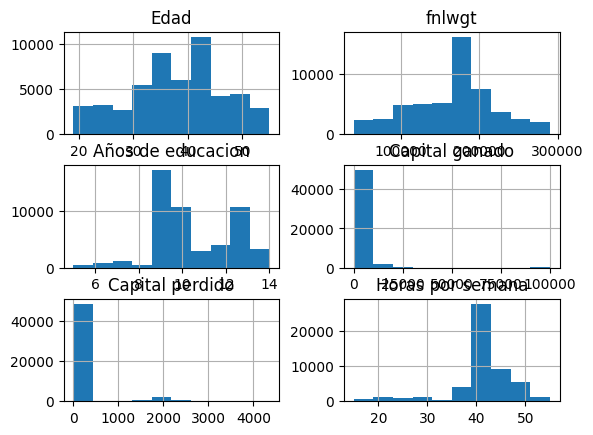

In [111]:
df.drop(['CLASE'],1).hist()

##**Librerías**

In [113]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sb
from sklearn.cluster import KMeans
from sklearn.metrics import pairwise_distances_argmin_min
from sklearn import metrics
import seaborn as sns
from sklearn.cluster import AgglomerativeClustering
from sklearn.cluster import DBSCAN
from sklearn.cluster import MeanShift
from sklearn.cluster import Birch
from sklearn.cluster import AffinityPropagation
from sklearn.cluster import MiniBatchKMeans
import numpy as np
from matplotlib import cm
from sklearn.metrics import silhouette_samples
import seaborn
from scipy.spatial.distance import pdist, squareform
from scipy.cluster.hierarchy import linkage
from scipy.cluster.hierarchy import dendrogram

##**Pairplot nuevo dataframe**

Es recomendable utilizar variables continuas originales del dataset en lugar de variables categóricas convertidas en continuas.

La razón es que las variables categóricas transformadas en continuas no reflejan su verdadera naturaleza y pueden llevar a interpretaciones erróneas en el análisis. 

Cuando se convierten variables categóricas en continuas, se les asigna un valor numérico a cada categoría. Esto puede no reflejar adecuadamente las diferencias entre las categorías y puede afectar la interpretación de la relación entre las variables.

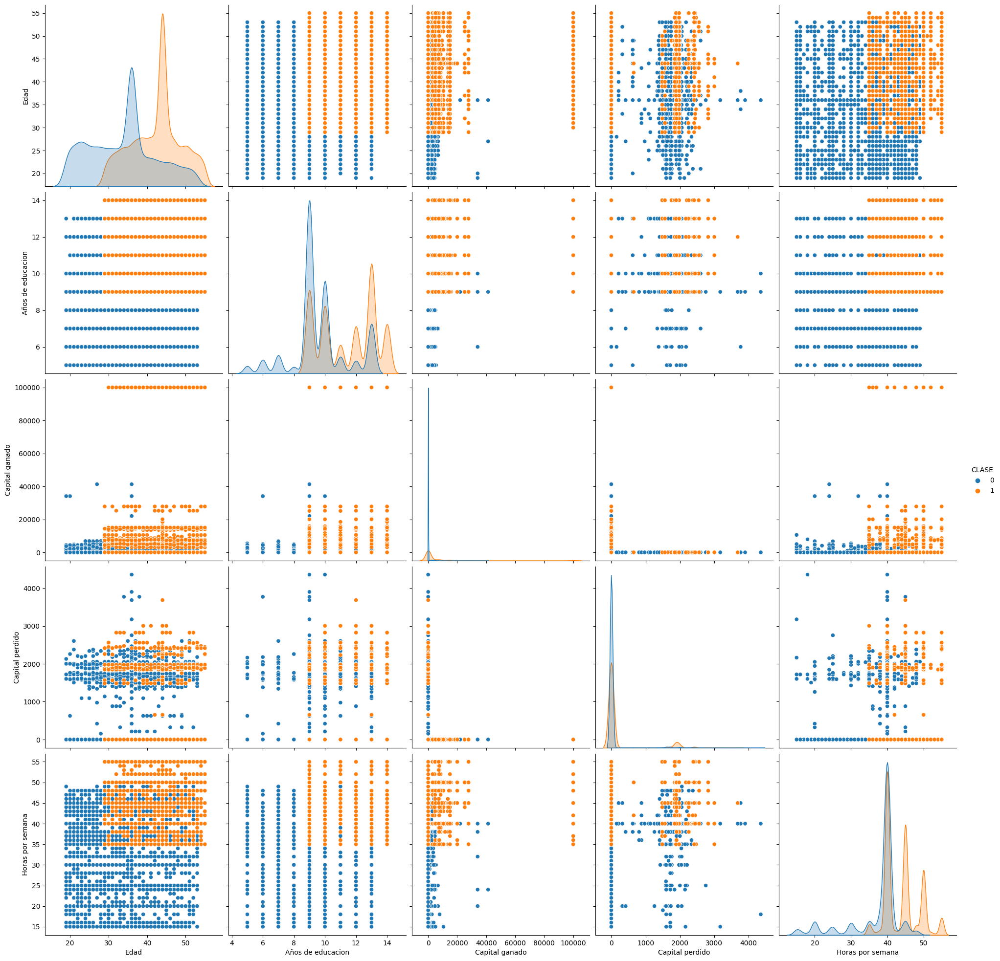

In [114]:
#Se aplica pairplot a las varibles continuas originales del dataset
sns.pairplot(df.dropna(), hue='CLASE', height = 4 , vars=['Edad', 'Años de educacion', 'Capital ganado','Capital perdido', 'Horas por semana'], kind='scatter')


## **Gráfico de dispersión variables continuas**

Basados en el resultado de la matriz de correlación para las variables númericas, generada en la sección Feature engineering, y las figuras anteriores, se procede a implementar la función snb.scatterplot para crear y posteriormente, analizar la dispersión entre las variables continuas del dataframe balanceado. 

### **Edad**

***Edad-Años de Educación vs CLASE***

<Axes: xlabel='Edad', ylabel='Años de educacion'>

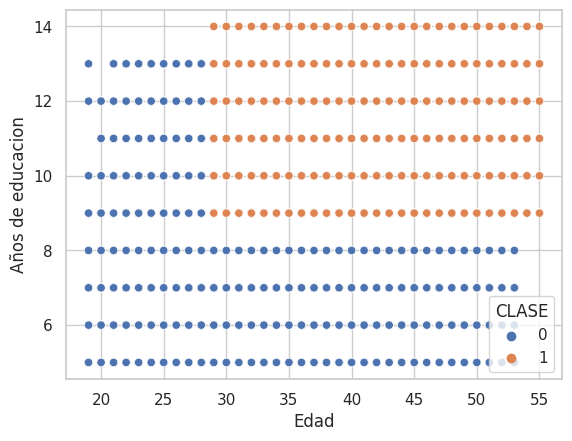

In [115]:
import seaborn as snb
snb.set(style='whitegrid')
snb.scatterplot(x="Edad", y="Años de educacion", hue="CLASE", data=df)

In [116]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
# Se seleccionan las columnas
num = df.shape[0]
x = df6['Edad'] 
y = df6['Años de educacion'];
labels = df['CLASE']
res = pd.DataFrame(dict(x=x, y=y, label=labels))
res

,x,y,label
0,22,9,0
1,30,13,0
2,41,11,1
3,36,9,0
4,44,9,1
...,...,...,...
52139,34,9,1
52140,33,10,1
52141,44,13,1
52142,39,12,1


In [117]:
# se agrupa por la etiqueta
groups = res.groupby('label')


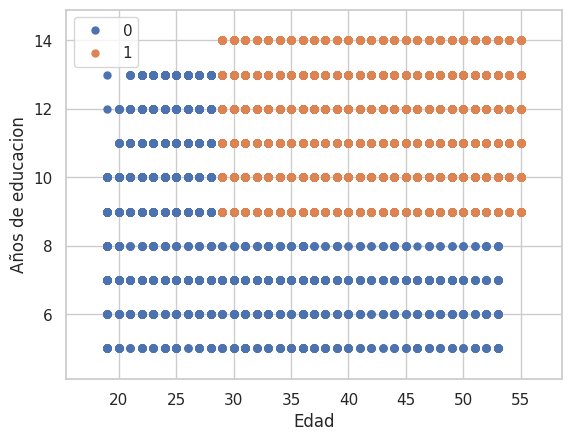

In [118]:
# Se construye el gráfico de dispersión
fig, ax = plt.subplots()
# Optional, just adds 10% padding to the autoscaling
ax.margins(0.1) 
for name, group in groups:
    ax.plot(group.x, group.y, marker='.', linestyle='', ms=10, label=name)
plt.xlabel('Edad')
plt.ylabel('Años de educacion')
ax.legend()

***Edad-Horas por semana vs CLASE***

<Axes: xlabel='Edad', ylabel='Horas por semana'>

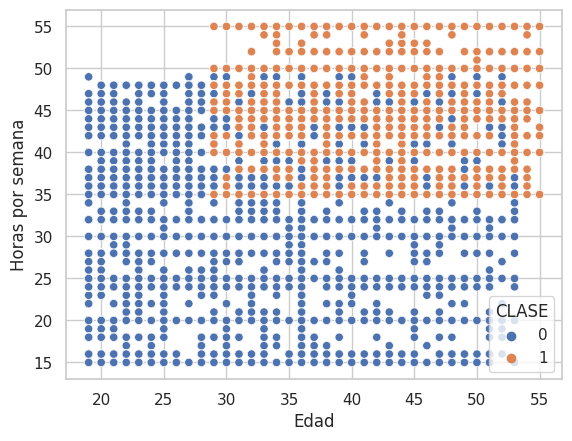

In [119]:
import seaborn as snb
snb.set(style='whitegrid')
snb.scatterplot(x="Edad", y="Horas por semana", hue="CLASE", data=df)

In [120]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
# Se seleccionan las columnas
num = df.shape[0]
x = df6['Edad'] 
y = df6['Horas por semana'];
labels = df['CLASE']
res = pd.DataFrame(dict(x=x, y=y, label=labels))
res

,x,y,label
0,22,40,0
1,30,40,0
2,41,40,1
3,36,40,0
4,44,45,1
...,...,...,...
52139,34,48,1
52140,33,41,1
52141,44,40,1
52142,39,50,1


In [121]:
# se agrupa por la etiqueta
groups = res.groupby('label')

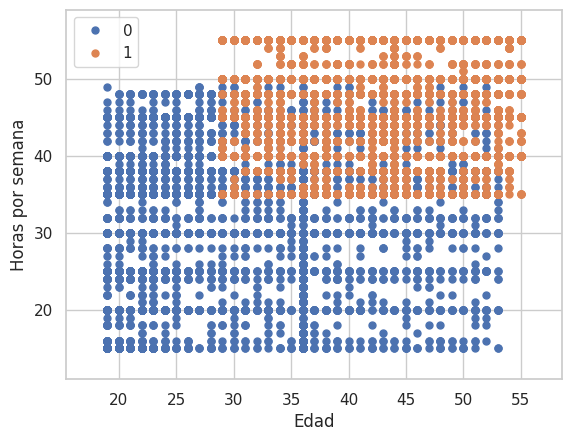

In [122]:
# Se construye el gráfico de dispersión
fig, ax = plt.subplots()
# Optional, just adds 10% padding to the autoscaling
ax.margins(0.1) 
for name, group in groups:
    ax.plot(group.x, group.y, marker='.', linestyle='', ms=10, label=name)
plt.xlabel('Edad')
plt.ylabel('Horas por semana'
)
ax.legend()

### **Años de educación**

***Años de educacion-Horas por semana vs CLASE***

<Axes: xlabel='Años de educacion', ylabel='Horas por semana'>

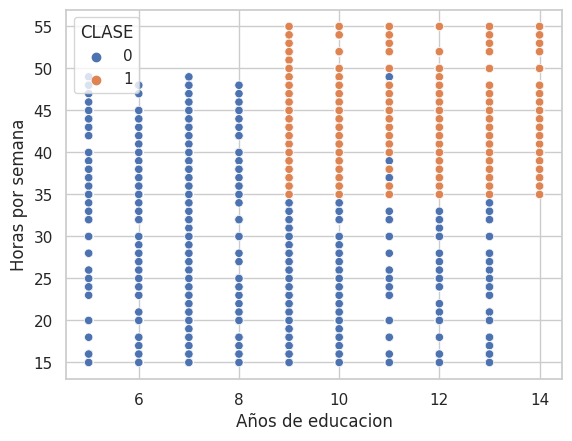

In [123]:
import seaborn as snb
snb.set(style='whitegrid')
snb.scatterplot(x="Años de educacion", y= "Horas por semana", hue="CLASE", data=df)

In [124]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
# Se seleccionan las columnas
num = df.shape[0]
x = df6['Años de educacion'] 
y = df6['Horas por semana'];
labels = df['CLASE']
res = pd.DataFrame(dict(x=x, y=y, label=labels))
res

,x,y,label
0,9,40,0
1,13,40,0
2,11,40,1
3,9,40,0
4,9,45,1
...,...,...,...
52139,9,48,1
52140,10,41,1
52141,13,40,1
52142,12,50,1


In [125]:
# se agrupa por la etiqueta
groups = res.groupby('label')

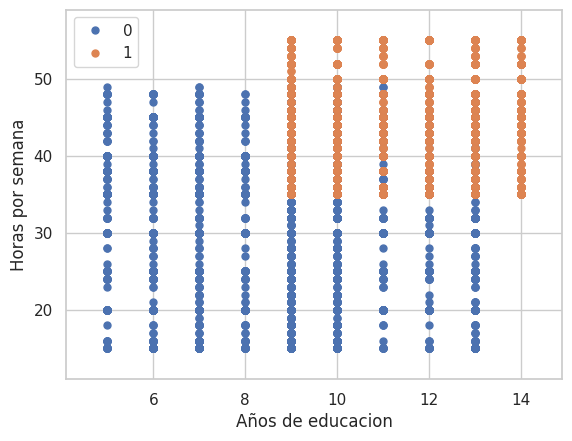

In [126]:
# Se construye el gráfico de dispersión
fig, ax = plt.subplots()
# Optional, just adds 10% padding to the autoscaling
ax.margins(0.1) 
for name, group in groups:
    ax.plot(group.x, group.y, marker='.', linestyle='', ms=10, label=name)
plt.xlabel('Años de educacion')
plt.ylabel('Horas por semana')
ax.legend()

### **Capital ganado**

***Capital ganado-Años de educación vs CLASE***

<Axes: xlabel='Capital ganado', ylabel='Años de educacion'>

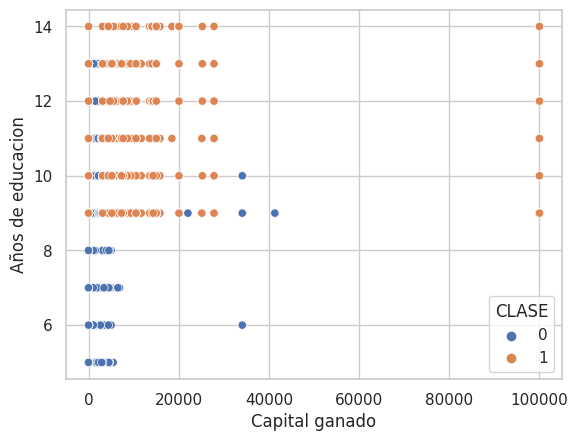

In [127]:
import seaborn as snb
snb.set(style='whitegrid')
snb.scatterplot(x="Capital ganado", y= "Años de educacion", hue="CLASE", data=df)

In [128]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
# Se seleccionan las columnas
num = df.shape[0]
x = df6['Capital ganado'] 
y = df6['Años de educacion'];
labels = df['CLASE']
res = pd.DataFrame(dict(x=x, y=y, label=labels))
res

,x,y,label
0,0,9,0
1,0,13,0
2,0,11,1
3,0,9,0
4,0,9,1
...,...,...,...
52139,0,9,1
52140,0,10,1
52141,0,13,1
52142,0,12,1


In [129]:
# se agrupa por la etiqueta
groups = res.groupby('label')

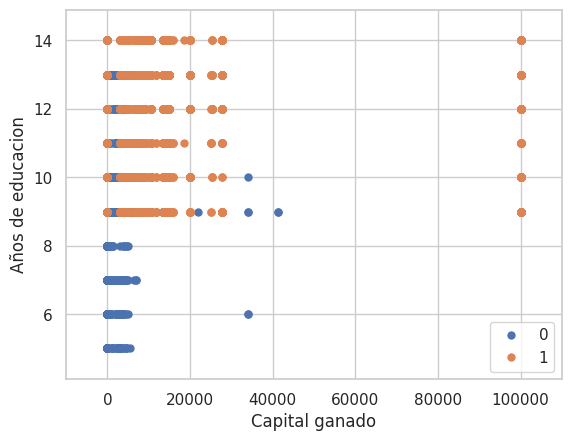

In [130]:
# Se construye el gráfico de dispersión
fig, ax = plt.subplots()
# Optional, just adds 10% padding to the autoscaling
ax.margins(0.1) 
for name, group in groups:
    ax.plot(group.x, group.y, marker='.', linestyle='', ms=10, label=name)
plt.xlabel('Capital ganado')
plt.ylabel('Años de educacion')
ax.legend()

Para analizar una imagen producida por un pairplot, podrías utilizar alguna de estas bibliotecas para identificar patrones y tendencias en los datos. Por ejemplo, si estás interesado en identificar los puntos que forman grupos o clusters, podrías utilizar técnicas de clustering como k-means o DBSCAN para agrupar los puntos y luego visualizar los grupos en la imagen.

Otra opción sería utilizar una red neuronal convolucional (CNN) para detectar patrones y características en la imagen, como formas y colores, y luego utilizar esta información para realizar un análisis más detallado de los datos.



## **Clustering - Kmeans**


K-means es un algoritmo de aprendizaje no supervisado utilizado en el análisis de clustering (agrupamiento) de datos. El objetivo del algoritmo K-means es agrupar datos en k grupos (clusters) basados en sus similitudes, donde k es un número predefinido de clusters.

El algoritmo comienza seleccionando aleatoriamente k centroides (centros de los clusters) en los datos. Luego, cada punto de datos se asigna al cluster cuyo centroide está más cercano a él. Después de asignar todos los puntos de datos a los clusters, se recalculan los centroides para que sean el centro de masa de todos los puntos asignados a ese cluster. Este proceso se repite iterativamente hasta que la asignación de puntos a clusters no cambia o hasta que se alcanza un número máximo de iteraciones.

In [131]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 52144 entries, 0 to 52143
Data columns (total 15 columns):
 #   Column             Non-Null Count  Dtype 
---  ------             --------------  ----- 
 0   Edad               52144 non-null  int64 
 1   Tipo de trabajo    52144 non-null  string
 2   fnlwgt             52144 non-null  int64 
 3   Educacion          52144 non-null  string
 4   Años de educacion  52144 non-null  int64 
 5   Estado civil       52144 non-null  string
 6   Ocupacion          52144 non-null  string
 7   Relacion           52144 non-null  string
 8   Raza               52144 non-null  string
 9   Sexo               52144 non-null  string
 10  Capital ganado     52144 non-null  int64 
 11  Capital perdido    52144 non-null  int64 
 12  Horas por semana   52144 non-null  int64 
 13  Pais origen        52144 non-null  string
 14  CLASE              52144 non-null  int64 
dtypes: int64(7), string(8)
memory usage: 6.0 MB


In [132]:
##preguntar los argumentos de x?

#Se seleccionan las dimensiones, 3 para poder graficar
y = np.array(df['CLASE'])
X = np.array(df[["Edad","Años de educacion","Horas por semana"]])

Nc = range(1, 20)
#se va a aplicar la tecnica del codo
kmeans = [KMeans(n_clusters=i) for i in Nc]
print("Kmeans")
print(kmeans)
score = [kmeans[i].fit(X).score(X) for i in range(len(kmeans))]
print (" El puntaje")
print (score)

Kmeans
[KMeans(n_clusters=1), KMeans(n_clusters=2), KMeans(n_clusters=3), KMeans(n_clusters=4), KMeans(n_clusters=5), KMeans(n_clusters=6), KMeans(n_clusters=7), KMeans(), KMeans(n_clusters=9), KMeans(n_clusters=10), KMeans(n_clusters=11), KMeans(n_clusters=12), KMeans(n_clusters=13), KMeans(n_clusters=14), KMeans(n_clusters=15), KMeans(n_clusters=16), KMeans(n_clusters=17), KMeans(n_clusters=18), KMeans(n_clusters=19)]
 El puntaje
[-6585054.7093817135, -3582580.2018416347, -2512134.4820030583, -1935220.764251181, -1550541.4465439878, -1339534.5279489004, -1138145.5492225813, -964198.3431302535, -871560.7088715113, -797355.103304631, -738836.8846093903, -699693.7575531725, -639597.8385809702, -623776.6138237462, -583146.0034089512, -543496.7716606702, -533248.9304678331, -499246.12381689256, -480170.2572211538]


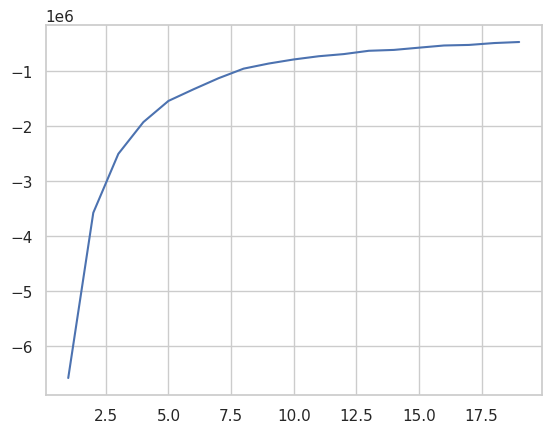

In [133]:
plt.plot(Nc,score)

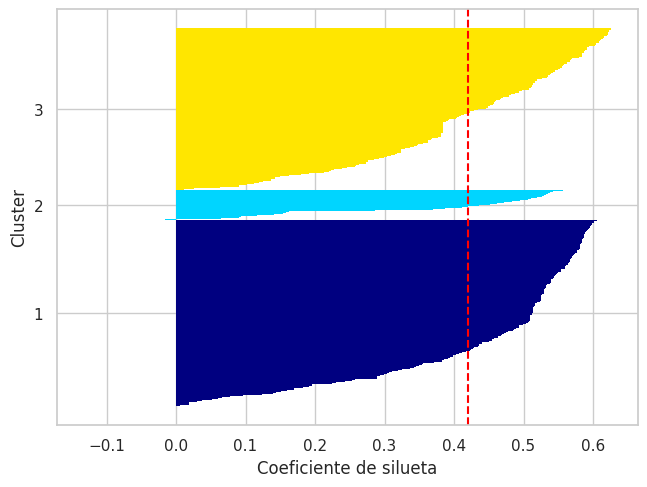

In [134]:
# basado en  Sebastian Raschka y Vahid Mijalili
kmeans = KMeans(n_clusters=3,
            init='k-means++', 
            random_state=1)
y_kmeans = kmeans.fit_predict(X)

cluster_labels = np.unique(y_kmeans)
silueta = silhouette_samples(X, y_kmeans, metric='euclidean')
n_clusters = cluster_labels.shape[0]
y_ax_lower, y_ax_upper = 0, 0
yticks = []

for i, c in enumerate(cluster_labels):
    c_silhouette_vals = silueta[y_kmeans == c]
    c_silhouette_vals.sort()
    y_ax_upper += len(c_silhouette_vals)
    #cambia el colormap
    color = cm.jet(float(i) / n_clusters)
    plt.barh(range(y_ax_lower, y_ax_upper), c_silhouette_vals, height=1.0, 
             edgecolor='none', color=color)

    yticks.append((y_ax_lower + y_ax_upper) / 2.)
    y_ax_lower += len(c_silhouette_vals)
    
silhouette_avg = np.mean(c_silhouette_vals)
plt.axvline(silhouette_avg, color="red", linestyle="--") 

plt.yticks(yticks, cluster_labels + 1)
plt.tight_layout()
plt.xlabel('Coeficiente de silueta')
plt.ylabel('Cluster')
plt.show()


array([[22,  9, 40],
       [30, 13, 40],
       [41, 11, 40],
       ...,
       [44, 13, 40],
       [39, 12, 50],
       [41, 12, 50]])

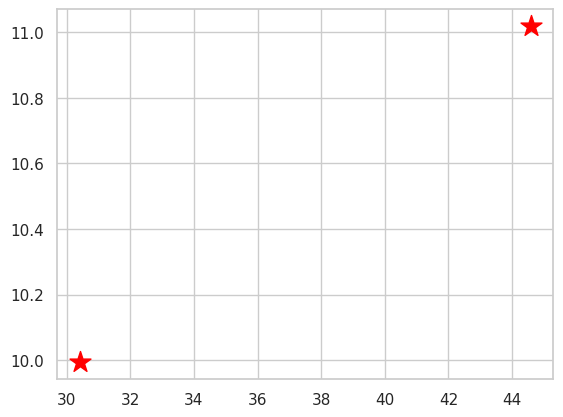

In [135]:
# Basado en Sebastian Raschka y Vahid Mijalili
kmeans = KMeans(n_clusters=2,
            init='k-means++',
            random_state=1)
y_kmeans = kmeans.fit_predict(X)
C = kmeans.cluster_centers_
plt.scatter(C[:, 0], C[:, 1],
            s=250, marker='*', c='red', label='centroids')

X

In [136]:
y_kmeans

array([0, 0, 1, ..., 1, 1, 1], dtype=int32)

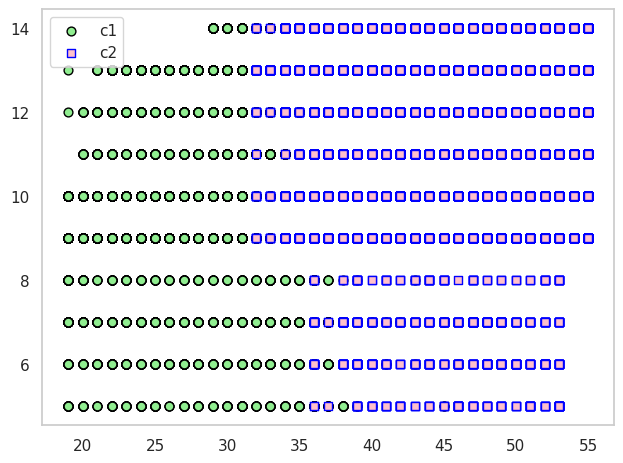

In [137]:
marker=['o', ]

plt.scatter(X[y_kmeans == 0, 0],
            X[y_kmeans == 0, 1],
            s=40,
            c='lightgreen',
            edgecolor='black',
            marker='o',
            label='c1')

plt.scatter(X[y_kmeans == 1, 0],
            X[y_kmeans == 1, 1],
            s=40,
            c='pink',
            edgecolor='blue',
            marker='s',
            label='c2')


plt.legend()
plt.grid()
plt.tight_layout()
plt.show()

In [ ]:
# tomado de Sebastian Raschka y Vahid Mijalili
cluster_labels = np.unique(y_kmeans)
n_clusters = cluster_labels.shape[0]
silhouette_vals = silhouette_samples(X, y_kmeans, metric='euclidean')
y_ax_lower, y_ax_upper = 0, 0
yticks = []
for i, c in enumerate(cluster_labels):
    c_silhouette_vals = silhouette_vals[y_kmeans == c]
    c_silhouette_vals.sort()
    y_ax_upper += len(c_silhouette_vals)
    color = cm.jet(float(i) / n_clusters)
    plt.barh(range(y_ax_lower, y_ax_upper), c_silhouette_vals, height=1.0, 
             edgecolor='none', color=color)

    yticks.append((y_ax_lower + y_ax_upper) / 2.)
    y_ax_lower += len(c_silhouette_vals)
    
silhouette_avg = np.mean(silhouette_vals)
plt.axvline(silhouette_avg, color="red", linestyle="--") 

plt.yticks(yticks, cluster_labels + 1)
plt.ylabel('Cluster')
plt.xlabel('Silhouette coefficient')

plt.tight_layout()
#plt.savefig('images/11_06.png', dpi=300)
plt.show()



In [ ]:
import pandas as pd
import numpy as np

out = ['ID_'+str(item) for item in range (0, df.shape[0])]
df.index = out

variables = ["ag","ne","wordcount"]
labels = out

#X = np.random.random_sample([5, 3])*10
df2 = pd.DataFrame(X, columns=variables, index=labels)
df2


In [ ]:
# tomado de Sebastian Raschka y Vahid Mijalili
row_dist = pd.DataFrame(squareform(pdist(df2, metric='euclidean')),
                        columns=labels,
                        index=labels)

row_clusters = linkage(df2.values, method='complete', metric='euclidean')
pd.DataFrame(row_clusters,
             columns=['fila label 1', 'fila label 2',
                      'distancia', 'cantidad items en cluster'],
             index=['cluster %d' % (i + 1)
                    for i in range(row_clusters.shape[0])])

dendograma = dendrogram(row_clusters, 
                       labels=labels,
                      )
plt.tight_layout()
plt.ylabel('Euclidean distance')
plt.show()



In [ ]:
# Se prueba con 3  clusters
kmeans = KMeans(n_clusters=3).fit(X)
centroids = kmeans.cluster_centers_
print('Centroides')
print(centroids)

In [ ]:
# Se obtienen las etiquetas de cada punto de nuestros datos
labels2 = kmeans.predict(X)
asignar=[]

colores=['red','green','blue']

for row in labels2:
    asignar.append(colores[row])

# Se obtienen  los centroides
C = kmeans.cluster_centers_
fig = plt.figure()
# Hacemos una proyeccion a 2D con los diversos ejes 
#["ag","ne","wordcount"]
f1 = df['ag'].values
f2 = df['ne'].values

plt.scatter(f1, f2, c=asignar, s=30)
plt.scatter(C[:, 0], C[:, 1], marker='*', c=colores, s=1000)
plt.show()

In [ ]:
# silhouette_avg = silhouette_score(X, cluster_labels)
from sklearn.metrics import silhouette_samples, silhouette_score
y_pred = kmeans.predict(X)
silhouette_avg = silhouette_score(X, y_pred)
print("For n_clusters =", 3,
          "The average silhouette_score is :", silhouette_avg)

In [ ]:
# se obtienen las etiquetas arrojadas por el kmeans
kmeans.labels_

In [ ]:
# se contruye el grafico, agregando la etiqueta de la clase
fig, ax = plt.subplots(figsize=(15, 10))
plt.scatter(C[:,0], C[:,1], c='r',  marker='*', s=50)

for i in range(len(centroids)):
    plt.annotate(i, (C[i][0], C[i][1]), fontsize=20)

In [ ]:
#el elemento más cercano al centroide
closest, _ = pairwise_distances_argmin_min(kmeans.cluster_centers_, X)
closest
users=df['usuario'].values
for row in closest:
    print("usuarios por fila")
    print(users[row])


In [ ]:
def performance_model(model, data, labels):
      print("Silueta: ", metrics.silhouette_score(data, model.labels_),
          "\n Homogeneity_score: ",metrics.homogeneity_score(labels, model.labels_),
            "\n Completeness_score: ", metrics.completeness_score(labels, model.labels_),
            "\n v_measure_score: ", metrics.v_measure_score(labels, model.labels_))

performance_model (kmeans,X, labels)


In [ ]:
X_new = np.array([[45.92,57.74,15.66]]) #se efectua una prediccion
new_labels = kmeans.predict(X_new)
print(new_labels)

## **Clustering aglomerativo**

Se construye basado en Dendograma

In [ ]:
aglomerativo = AgglomerativeClustering(n_clusters = 5).fit(X)
labels = kmeans.predict(X)
performance_model (aglomerativo,X, labels)

DBscan

Basado en densidad

In [ ]:
dbScan = DBSCAN(eps=0.45, min_samples=4).fit(X)
labels = kmeans.predict(X)
performance_model (aglomerativo,X, labels)

## **Hyperparameter Tuning**

In [ ]:
from sklearn import metrics
from sklearn.metrics import silhouette_score
from sklearn.model_selection import ParameterGrid
from sklearn.cluster import KMeans
from sklearn.cluster import DBSCAN
from sklearn.cluster import MeanShift

In [ ]:
def hallarMejorParametro (parameter_grid, model):
  mejor_puntaje = -1 
  mejor_parametro = 0
  for g in parameter_grid:
    model.set_params(**g)
    model.fit(df2)
    # check how many unique labels do you have
    res = np.unique(model.labels_)
    #print ("shape")
    #print (res.shape)
    if res.shape[0]>1:
      coeficiente_silueta = metrics.silhouette_score(df2, model.labels_)
      print('parametro: ', g, 'puntaje: ', coeficiente_silueta)
      if coeficiente_silueta >= mejor_puntaje:
          mejor_puntaje = coeficiente_silueta
          mejor_parametro = g
  

  return mejor_parametro

In [ ]:
dataframe = pd.read_csv('/content/drive/MyDrive/datasets/analisis.csv')
df2 = dataframe.drop(['categoria','usuario', ], axis=1)
Nc = range(2, 21)
parametros = {'n_clusters': Nc}

parameter_grid = ParameterGrid(parametros)

list(parameter_grid)
model = KMeans()
mejor_p= hallarMejorParametro (parameter_grid, model)
print (mejor_p)

## **DBSCAN**

In [ ]:
dataframe = pd.read_csv('/content/drive/MyDrive/datasets/iris.csv')
dataframe

In [ ]:
df2 = dataframe.drop(['variety'], axis=1)
#epsilon
parametros = {'eps': [ 0.1, 0.2, 0.5, 0.8, 0.6],
              'min_samples': [ 7, 8, 10, 15]}

parameter_grid = ParameterGrid(parametros)
list(parameter_grid)
model = DBSCAN()
mejor_p = 0;
mejor_p= hallarMejorParametro (parameter_grid, model)
print (mejor_p)

## **Agglomerative clustering**

In [ ]:
dataframe = pd.read_csv('/content/drive/MyDrive/datasets/analisis.csv')
df2 = dataframe.drop(['categoria','usuario', ], axis=1)
Nc = range(2, 21)
parametros = {'n_clusters': Nc}

parameter_grid = ParameterGrid(parametros)

parameter_grid = ParameterGrid(parametros)
list(parameter_grid)
model = AgglomerativeClustering()
mejor_p = 0;
mejor_p= hallarMejorParametro (parameter_grid, model)
print (mejor_p)

# **Reglas**

**RIPPER**

In [ ]:
df0 = df6
# se toman todas las variables menos la clase
X = df0.drop('CLASE', axis=1)
# se toma la clase
y = df0['CLASE']
# Se particiona el dataset en entrenamiento y prueba
#train, test = train_test_split(df, test_size=.33,  random_state=42)
# esta instrucción separa clase de las otras variables, pero el algoritmo 
# pide que estén juntos por eso no particionamos así
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=1) 
#df0
df0.info()

In [ ]:
!pip install wittgenstein
import wittgenstein as lw
clf = lw.RIPPER()

# valores que toma la clase 'e' y 'p'. Se le debe dar uno de lo valores
#clf.fit(entrenamiento, class_feat='class', pos_class='e', random_state=2)
clf.fit(X_train, y_train, pos_class='e', random_state=1)

#X_test = test.drop('class', axis=1)
#y_test = test['class']

In [ ]:
from sklearn.metrics import precision_score, recall_score
precision = clf.score(X_test, y_test, precision_score)
recall = clf.score(X_test, y_test, recall_score)
cond_count = clf.ruleset_.count_conds()

print(f'precision: {precision} recall: {recall} conds: {cond_count}')

In [ ]:
# se presentan las reglas, estas están formadas por una disjunción de conjunciones
# en donde se usan los operadores 'V' (or) e '^' (y)
clf.ruleset_.out_pretty()

In [ ]:
# se le consulta  por qué hizo cada predicción positiva,es decir
# cual regla aplicó,  usando give_reasons:
clf.predict(X_test[0:3], give_reasons=True)

**OneRClassifier**

In [ ]:
# Ejemplo tomado de http://rasbt.github.io/mlxtend/user_guide/classifier/OneRClassifier/
# buena referencia
#https://towardsdatascience.com/the-art-of-sprezzatura-for-machine-learning-e2494c0db727

!pip install mlxtend
!pip install imodels
import six
import sys
import numpy as np
#sys.modules['sklearn.externals.six'] = six
import mlxtend
#from mlxtend.classifier import OneRClassifier
from sklearn.pipeline import Pipeline
from imodels import OneRClassifier
#from sklearn.preprocessing import StandardScaler
from sklearn import neighbors, datasets, preprocessing
from mlxtend.data import iris_data
# info del dataset iris en https://archive.ics.uci.edu/ml/datasets/iris
# 1. sepal length in cm
# 2. sepal width in cm
# 3. petal length in cm
# 4. petal width in cm
# 5. class: -- Iris Setosa -- Iris Versicolour -- Iris Virginica
X, y = iris_data()
X[:15]

In [ ]:
y

In [ ]:
def get_feature_quartiles(X):
    discretizado = X.copy()
    for col in range(X.shape[1]):
        for q, class_label in zip([1.0, 0.75, 0.5, 0.25], [3, 2, 1, 0]):
            threshold = np.quantile(X[:, col], q=q)
            discretizado[X[:, col] <= threshold, col] = class_label
    return discretizado.astype(np.int)

x_Discretizado = get_feature_quartiles(X)
x_Discretizado[:15]

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

x_Discretizado_train, x_Discretizado_test, y_train, y_test = train_test_split(x_Discretizado, y, random_state=0, stratify=y)
clf =  OneRClassifier()

#https://scikit-learn.org/stable/auto_examples/miscellaneous/plot_pipeline_display.html
clf = Pipeline(steps=[('scaler', StandardScaler()),('classifier', OneRClassifier())])
# se despliega el pipeline
clf

In [ ]:
#clf.predict(x_Discretizado_test[0:1])

In [ ]:
clf2 =  OneRClassifier()
clf2.fit(x_Discretizado_train, y_train)

In [ ]:
clf2.predict(x_Discretizado_test[0:3])

In [ ]:
# http://rasbt.github.io/mlxtend/user_guide/classifier/OneRClassifier/
test_acc = clf2.score(x_Discretizado_test, y_test)
print(f'Accuracy {test_acc*100:.2f}%')

In [ ]:
clf2.rules_

In [ ]:
from mlxtend.classifier import OneRClassifier
oner = OneRClassifier()
oner.fit(x_Discretizado_train, y_train);
oner.feature_idx_

In [ ]:
oner.prediction_dict_
# tomado de http://rasbt.github.io/mlxtend/user_guide/classifier/OneRClassifier/
# rules (value: class)': {0: 0, 1: 1, 2: 1, 3: 2} means that there are 3 rules 
# for the selected feature (petal length): 
#- if value is 0, classify as 0 (Iris-setosa) 
#- if value is 1, classify as 1 (Iris-versicolor) 
#- if value is 2, classify as 1 (Iris-versicolor) 
#- if value is 3, classify as 2 (Iris-virginica)

In [ ]:
oner.predict(x_Discretizado_train)

In [ ]:
test_acc = oner.score(x_Discretizado_test, y_test)
print(f'Test accuracy {test_acc*100:.2f}%')